In [ ]:
import pickle
# import matlab.engine
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import scipy
from scipy import signal
import pickle
import pandas as pd
# there were a lot of deprecation warnings
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from scipy.signal import butter,filtfilt

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import pickle
import os
from sklearn.cluster import AgglomerativeClustering

# there were a lot of deprecation warnings
import warnings

warnings.filterwarnings('ignore', category=DeprecationWarning)


def get_hour(hour: int, dir='/home/yandex/BrainW2021/projects/ML_Ofir_Eden_Eden/Data/pickel_files'):
    """
    Gets data of a specific hour as np.array,
    given the directory and files are in the specific format:
    file name is 'Hour#' and is in a directory called dir,
    prints data's size
    :param hour: hour in int
    :param dir: name of data directory
    :return: data as np.array (prints it's size)
    """
    filename = dir + os.path.sep + 'Hour' + str(hour)
    # TODO: if using jupyter, replace with following line:
    # filename = 'Hour' + str(hour)
    with open(filename, 'rb') as data_file:
        data = pickle.load(data_file)
        data = np.array(data)
        print("data.size = " + str(data.size))
        return data


def plot_data(data: np.array, title: str):
    """
    :param data: raw recording
    :param title: title of graph
    shows / saves a plot of the data
    """
    plt.figure(figsize=(13, 4))
    plt.plot(data)
    plt.title(title, fontsize=20)
    plt.ylabel('Voltage', fontsize=16)
    plt.xlabel('Time', fontsize=16)
    plt.show()
#     plt.savefig('data')
    plt.close()


def welch_psd_per_bin(data: np.array, bin_length_sec=10, sf=20000,
                      nperseg=20000, noverlap=10000, scaling='spectrum'):
    """
    :param data: 1 hour of data
    :param bin_length_sec:  length of bins in seconds
    :params sf: sample frequency (samples/second)
    :param nperseg: length of segment in samples
    :param noverlap: overlap between segments in samples
    :param scaling: no reason to change default
    :return: array of relevant frequencies, array of their magnitudes
    """
    samples_per_bin = bin_length_sec * sf
    spectrum = []
    for i in range(int(data.size / samples_per_bin)): # for each bin compute the spectrum
        single_bin = data[i * samples_per_bin:samples_per_bin * (i + 1)]
        frequencies, density = signal.welch(single_bin, fs=sf, nperseg=nperseg, noverlap=noverlap, scaling=scaling)
        spectrum.append(density)
    return frequencies, np.array(spectrum)


def show_spectogram(frequencies, spectrum: np.array, size=360):
    """
    :param frequencies: relevant frequencies - eventually takes the first 30
    :param spectrum: magnitudes of the relevant frequencies in each bin
    :param size: number of bins (default is one hour with bins' length 10sec - 360
    :return: shows / saves spectogram
    """
    # segmentation and plot
    plt.figure()
    plt.pcolormesh([i for i in range(size)], frequencies[:30], np.abs(np.log(np.transpose(spectrum[:, :30]))),
                   shading='gouraud')
    plt.title('STFT Magnitude')
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time')
    plt.show()
#     plt.savefig('spectogram')
    plt.close()


def show_normalized_spectogram(frequencies, spectrum: np.array, no_show=False, size=360):
    """
    :param frequencies: relevant frequencies - eventually takes the first 30
    :param spectrum: magnitudes of the relevant frequencies in each bin
    :param size: number of bins (default is one hour with bins' length 10sec - 360
    :param no_show: if there's no need to show the spectogram
    :return: normalized magnitudes for the frequencies (shows/saves spectogram figure)
    """
    # normalize spectogram data
    low_freq_power = spectrum[:, :30]  # all bins, frequencies upto 30Hz
    # calculate avarage freq power
    avg_freq_power = low_freq_power.mean(axis=0)  # for each frequency, its average magnitude
    norm_freq_power = low_freq_power / avg_freq_power
    # segmentation and plot
    if no_show:
        return norm_freq_power
    plt.figure()
    plt.pcolormesh([i for i in range(size)], frequencies[:30], np.abs((np.transpose(norm_freq_power))),
                   shading='gouraud')
    plt.title('STFT Normalized Magnitude')
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time')
    plt.show()
#     plt.savefig('normalized_spectogram')
    plt.close()
    return norm_freq_power


def show_corr_mat(norm_freq_power, no_show=False):
    low_freq_magnitudes = np.abs(norm_freq_power)
    # compute correlation matrix of frequencies magnitudes
    corr_mat = np.corrcoef(low_freq_magnitudes)  # by pearson
    corr_mat.shape
    if no_show:
        return corr_mat, low_freq_magnitudes
    plt.figure()
    plt.imshow(corr_mat)
    plt.colorbar()
    plt.show()
    #     plt.savefig('corr_mat')
    plt.close()
    return corr_mat, low_freq_magnitudes


def show_clustered_data(corr_mat, low_freq_magnitudes, no_show=False):
    # re-organize the segments according to clusters
    ward_clusters = AgglomerativeClustering(linkage='ward').fit(corr_mat)
    indices = np.argsort(ward_clusters.labels_)
    magnitudes_by_clusters = low_freq_magnitudes[indices]
    corr_mat_by_clusters = np.corrcoef(magnitudes_by_clusters)
    corr_mat_by_clusters.shape
    if no_show:
        return ward_clusters
    plt.figure()
    plt.imshow(corr_mat_by_clusters)
    plt.clim(-1, 1)
    plt.colorbar()
    plt.show()
    #     plt.savefig('clustered_data')
    plt.close()
    return ward_clusters


def divide_to_clusters(ward_clusters, norm_freq_power):
    low_freq_magnitudes = (np.abs(norm_freq_power[:, :30]))
    lables = ward_clusters.labels_
    indxes_cls1 = np.where(lables == 0)[0]
    indxes_cls2 = np.where(lables == 1)[0]
    cls1 = low_freq_magnitudes[indxes_cls1, :30]
    cls2 = low_freq_magnitudes[indxes_cls2, :30]
    return cls1, cls2


# cal the freqs
def avrg_freq_per_cluster(cls_group):  # cls_group is for each bin in cls, its spectrum
    cls_len = cls_group.shape[0]  # num of bins in cls
    relevant_freqs = cls_group.shape[1]  # num of different frequencies
    cls_freqs = [0] * relevant_freqs  # 0 for each frequency
    for vec in cls_group:  # for each bin's spectrum
        for i in range(relevant_freqs):  # for each frequency
            cls_freqs[i] += vec[i]  # cls_freqs[i] += magnitude of that frequency in that bin
    cls_freqs = np.divide(cls_freqs, cls_len)  # cls_freqs is now mean magnitude for each frequency in cls
    return cls_freqs


def show_graph(cls1_freqs, cls2_freqs, frequencies):
    plt.figure()
    plt.plot(frequencies[:30], cls1_freqs)
    plt.plot(frequencies[:30], cls2_freqs)
    plt.show()
    #     plt.savefig('graph')
    plt.close()
    return


def all(data):
    frequencies, spectrum = welch_psd_per_bin(data)
    show_spectogram(frequencies, spectrum)
    norm_freq_power = show_normalized_spectogram(frequencies, spectrum)
    corr_mat, low_freq_magnitudes = show_corr_mat(norm_freq_power)
    ward_clusters = show_clustered_data(corr_mat, low_freq_magnitudes)
    cls1, cls2 = divide_to_clusters(ward_clusters, norm_freq_power)
    show_graph(avrg_freq_per_cluster(cls1), avrg_freq_per_cluster(cls2), frequencies)


def graph_e_row(data):
    frequencies, spectrum = welch_psd_per_bin(data)
    norm_freq_power = show_normalized_spectogram(frequencies, spectrum, no_show=True)
    corr_mat, low_freq_magnitudes = show_corr_mat(norm_freq_power, no_show=True)
    ward_clusters = show_clustered_data(corr_mat, low_freq_magnitudes, no_show=True)
    cls1, cls2 = divide_to_clusters(ward_clusters, norm_freq_power)
    delta = np.arange(4)
    beta = np.arange(4, 30)
    sleep_states = np.array([0.0] * norm_freq_power.shape[0])
    for i, bin in enumerate(norm_freq_power):  # 30 minutes
        delta_magnitude_bin = bin[delta].mean()  # average magnitude of delta frequencies in bin
        beta_magnitude_bin = bin[beta].mean()  # average magnitude of beta frequencies in bin
        sleep_states[i] = delta_magnitude_bin / beta_magnitude_bin
    return sleep_states


def show_graph_e():
    sleep_states = np.array([[0.0] * 180] * 32)
    for i in range(0, 32, 2):
        data = get_hour(int(i / 2))
        sleep_states_hour = graph_e_row(data)
        sleep_states[i] = sleep_states_hour[:180]
        sleep_states[i + 1] = sleep_states_hour[180:]
    plt.figure(figsize=(8.67, 5.33))
    plt.imshow(sleep_states, extent=[0, 30, 0, 17])
    cbar = plt.colorbar()
    cbar.set_label('delta to beta ratio', rotation=270)
    plt.show()
    #     plt.savefig()
    plt.close()

/home/yandex/BrainW2021/projects/ML_Ofir_Eden_Eden/Python_env/liz/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/home/yandex/BrainW2021/projects/ML_Ofir_Eden_Eden/Python_env/liz/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/

In [ ]:
# functions for easy work
     
def plot_data(data: np.array, title: str):
    plt.figure(figsize=(13,4))
    plt.plot(data)
    plt.title(title, fontsize=20)
    plt.ylabel('Voltage', fontsize=16)
    plt.show()
    
def low_pass_filter(data: np.array, T=3600.0, fs=20000.0, cutoff=100, order=2):
    # Filter requirements.
    # T = 3600.0         # Sample Period, sec
    # fs = 20000.0       # sample rate, Hz
    # cutoff = 100      # desired cutoff frequency of the filter, Hz ,      slightly higher than actual 1.2 Hz
    # order = 2       # sin wave can be approx represented as quadratic
    nyq = 0.5 * fs  # Nyquist Frequency
    n = int(T * fs) # total number of samples
    
    # Filter the data,
    normal_cutoff = cutoff / nyq
    # Get the filter coefficients
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = filtfilt(b, a, data)
    return y
    
def downsample(data: np.array, sample_rate=20000.0, downsample_rate=250.0):
    # sample_rate = 20000.0
    # downsample_rate = 250.0
    downsample_factor = sample_rate / downsample_rate
    downsampled_data = scipy.signal.decimate(data, int(downsample_factor))
    return downsampled_data

def autocorrelation_order(data: np.array, log_range=7):
    autocorrelation = []
    correlation = np.corrcoef(data, data)[0,1]
    print(correlation)
    autocorrelation.append(correlation)
    for log_shift in range(7):
        shift = 10 ** log_shift
        correlation = np.corrcoef(data[:-shift], data[shift:])[0,1]
        print(shift)
        print(correlation)
        autocorrelation.append(correlation)
    plt.plot(autocorrelation)
    plt.title('Autocorrelation: change in order size shifts', fontsize=20)
    plt.show()
    
def my_autocorrelation(data: np.array, shifts_range, shifts_jump=1, shifts_lst=[]):
    autocorrelation = []
    correlation = np.corrcoef(data, data)[0,1]
    autocorrelation.append(correlation)
    if shifts_lst != []:
        shifts = shifts_lst
    else:
        shifts = range(1, shifts_range, shifts_jump)
    for shift in shifts:
        correlation = np.corrcoef(data[:-shift], data[shift:])[0,1]
        if shifts_lst != []:
            print("shift = " + str(shift))
            print("correlation = " + str(correlation))
        autocorrelation.append(correlation)
    return autocorrelation

def plot_statesmodel_autocorrelation(data: np.array):
    print(data.size)
    with mpl.rc_context():
        mpl.rc("figure", figsize=(13,4))
        plot_acf(data)
        
def data_presentation(data: np.array, start:tuple, end: tuple):
    plot_data(data, 'Raw Data - Wakefulness : %d:%d:%d-%d:%d:%d' % (start[0], start[1], start[2], end[0], end[1], end[2]))
    # low pass filter
    lpf_data = low_pass_filter(data)
    plot_data(lpf_data, 'Raw Data - Wakefulness : %d:%d:%d-%d:%d:%d, Butter Low Pass Filter' % (start[0], start[1], start[2], end[0], end[1], end[2]))
    # downsample
#     ds_data = downsample(data)
#     plot_data(ds_data, 'Raw Data - Wakefulness : %d:%d:%d-%d:%d:%d, downsampled to 250Hz' % (start[0], start[1], start[2], end[0], end[1], end[2]))

def minute_to_sample(minute: int, sample_rate=20000, start_sample=0):
    return second_to_sample(60*minute, start_sample)

def second_to_sample(second: int, sample_rate=20000, start_sample=0):
    return second * 20000 + start_sample

In [ ]:
data14 = get_hour(14)

data.size = 72000000


In [ ]:
data7 = get_hour(7)

data.size = 72000000


200000


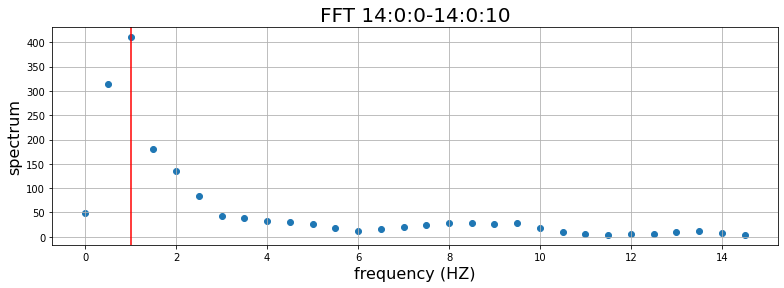

200000


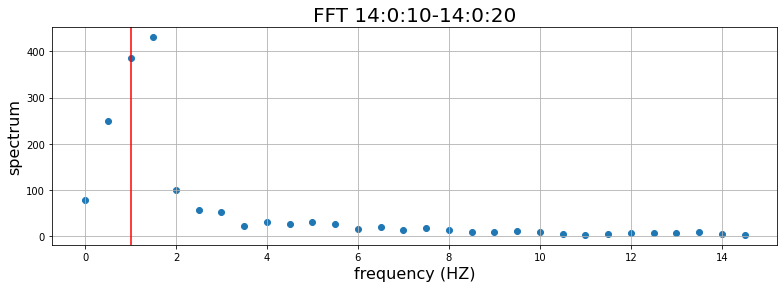

200000


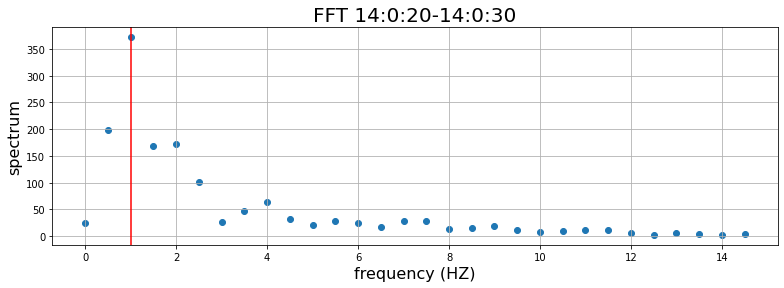

200000


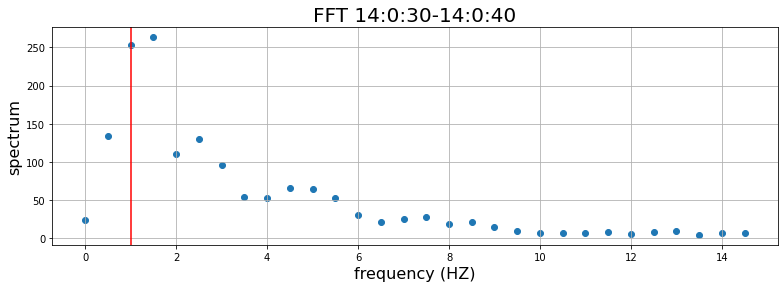

200000


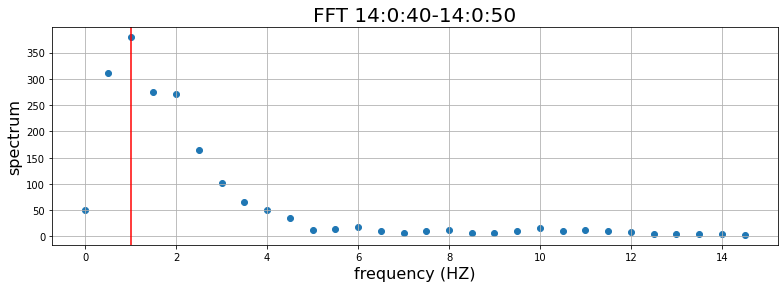

200000


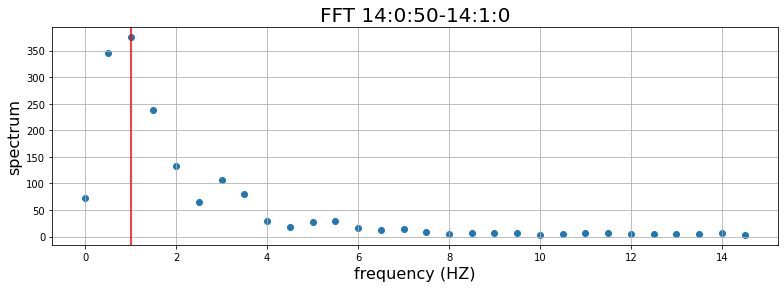

200000


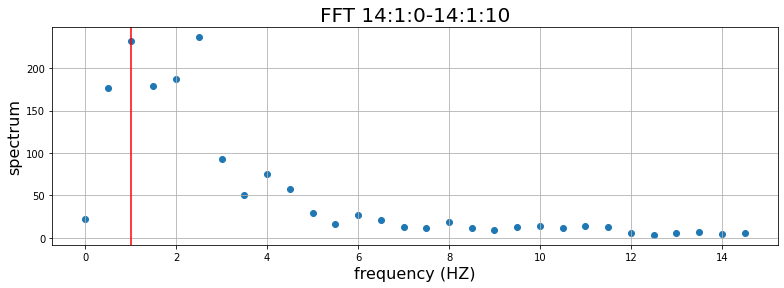

200000


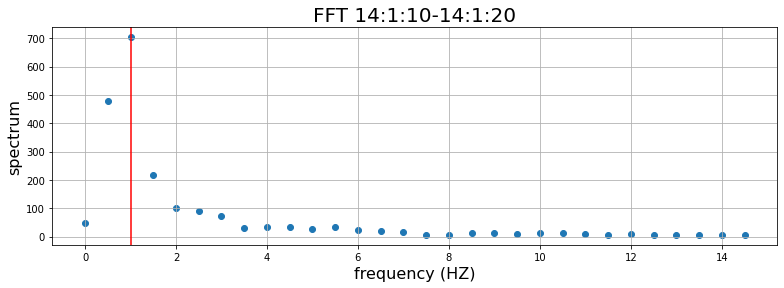

200000


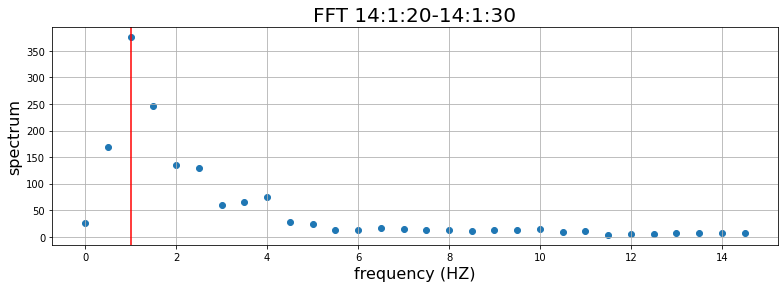

200000


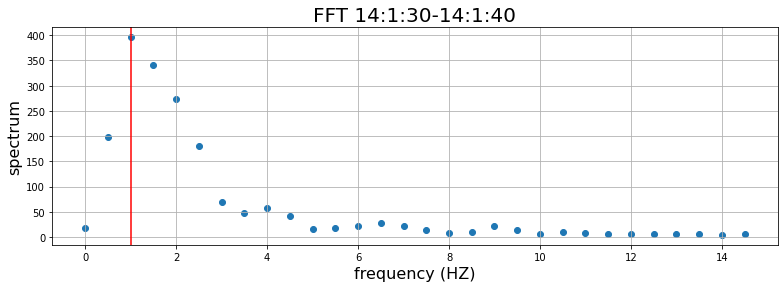

200000


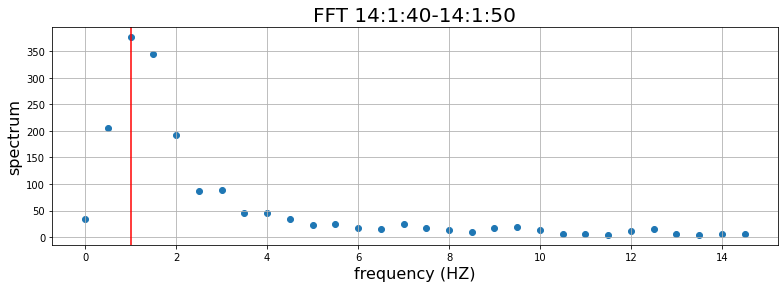

200000


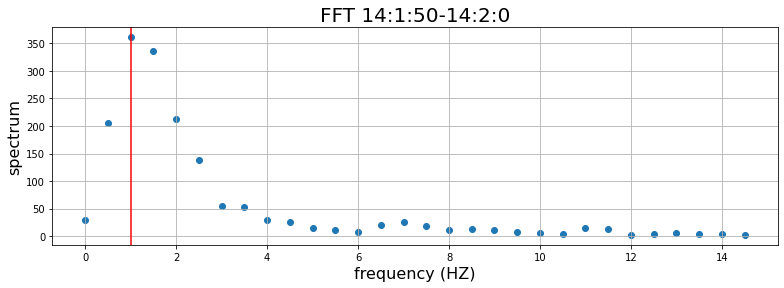

200000


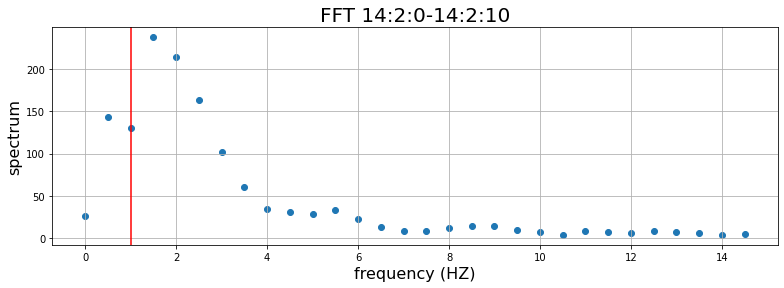

200000


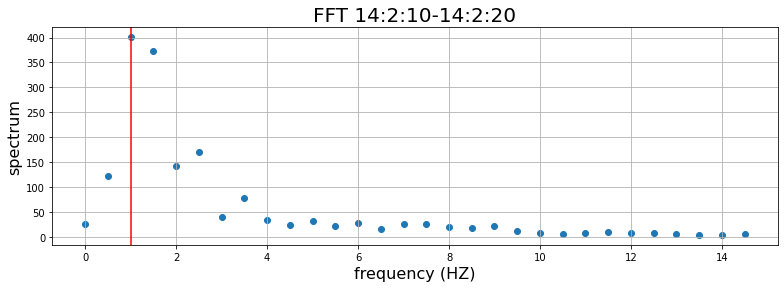

200000


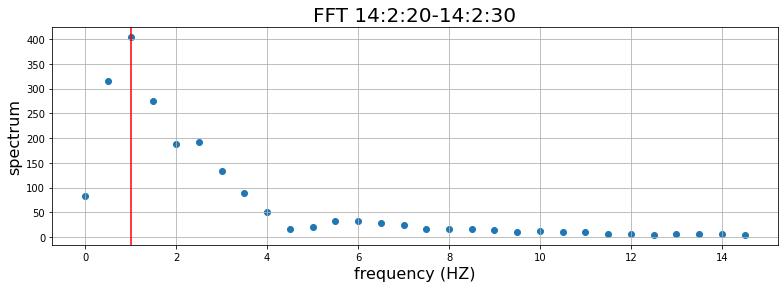

200000


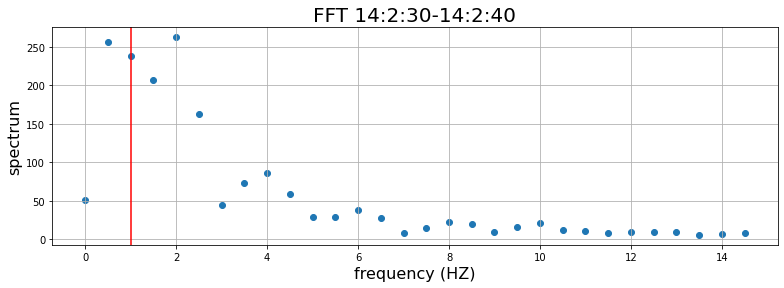

200000


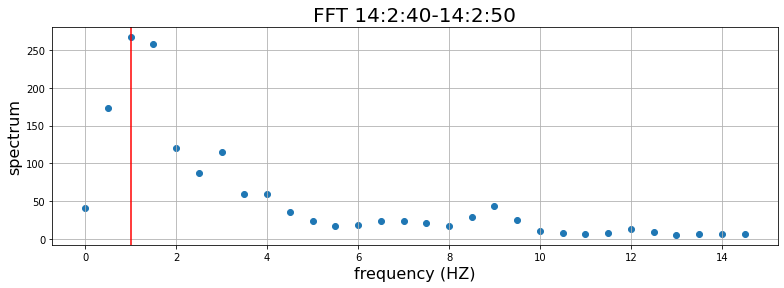

200000


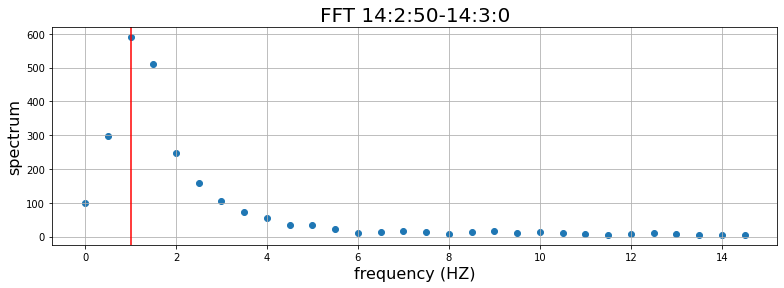

200000


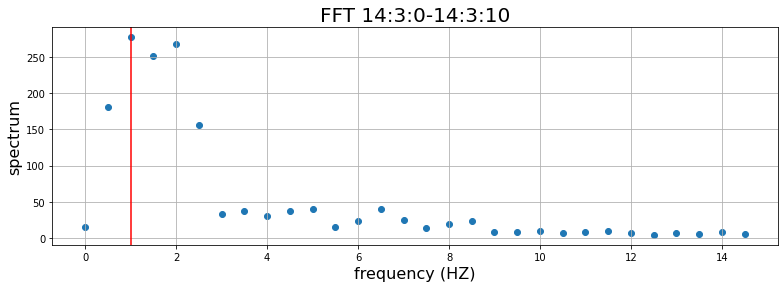

200000


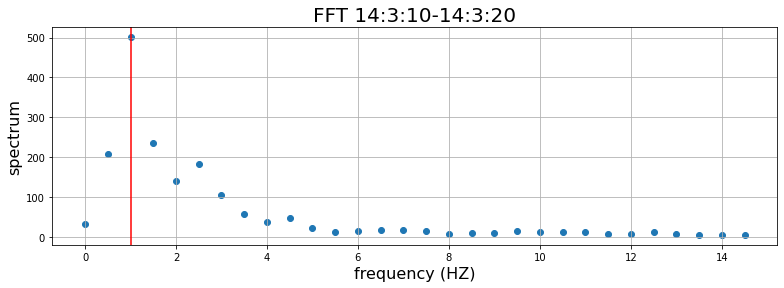

200000


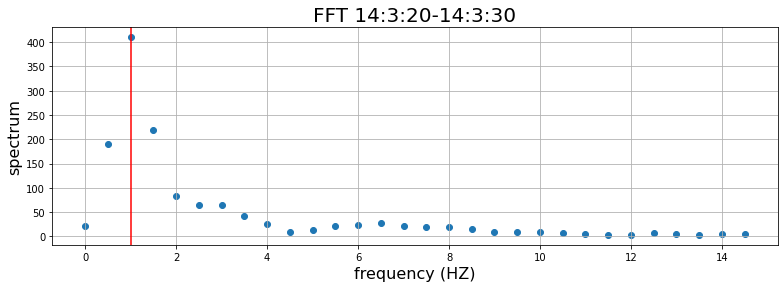

200000


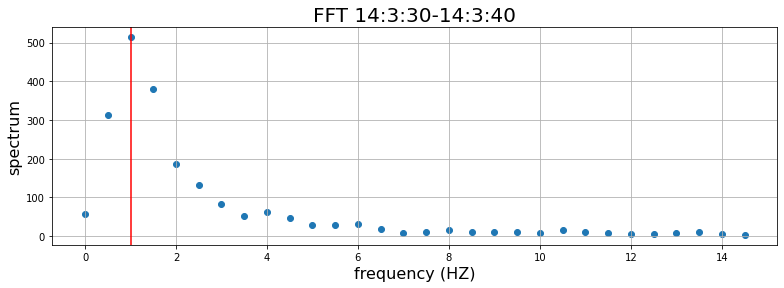

200000


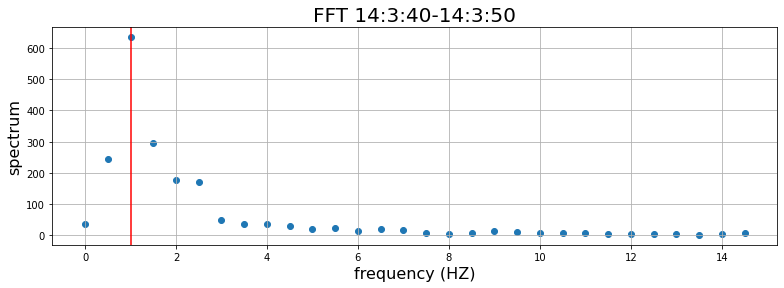

200000


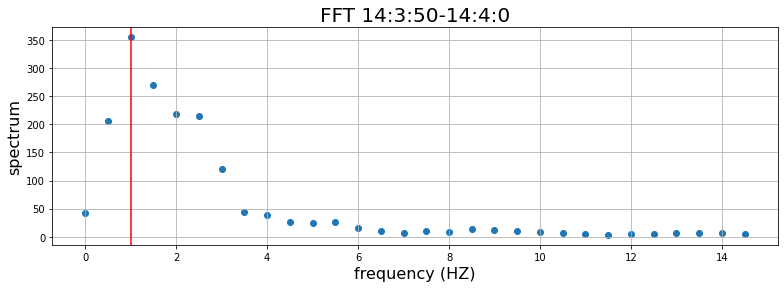

200000


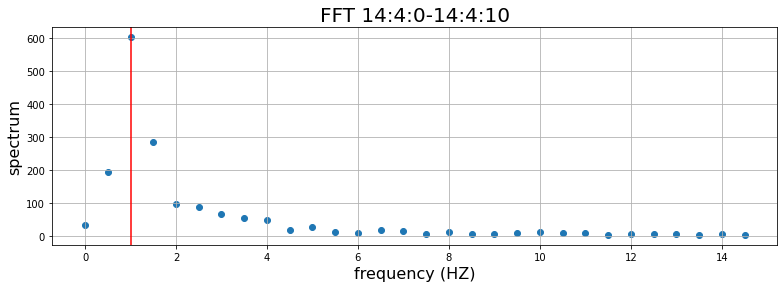

200000


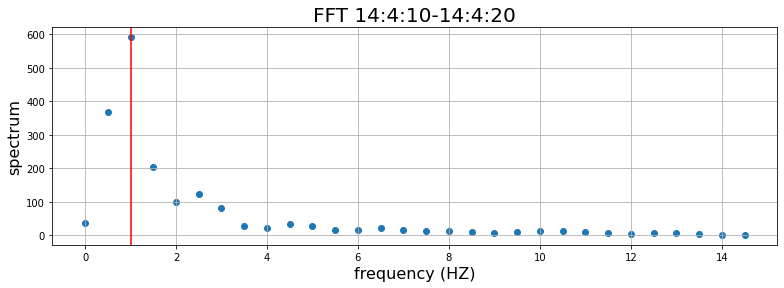

200000


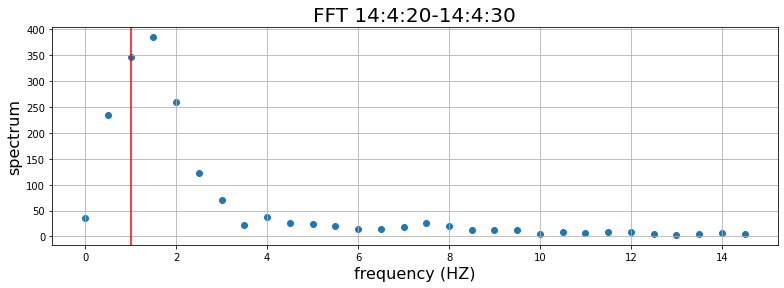

200000


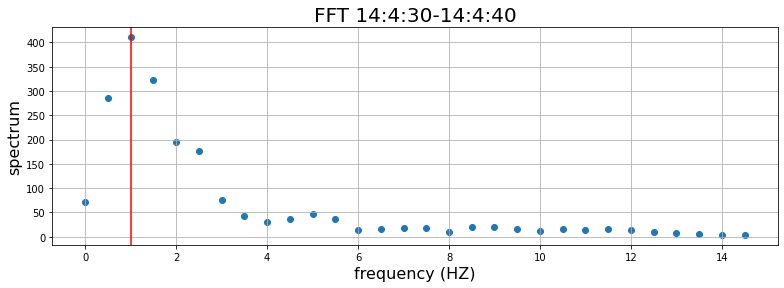

200000


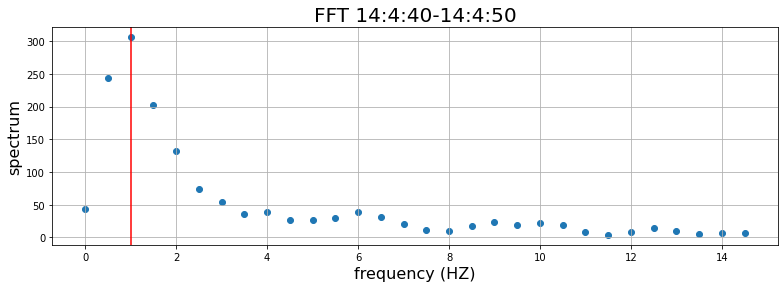

200000


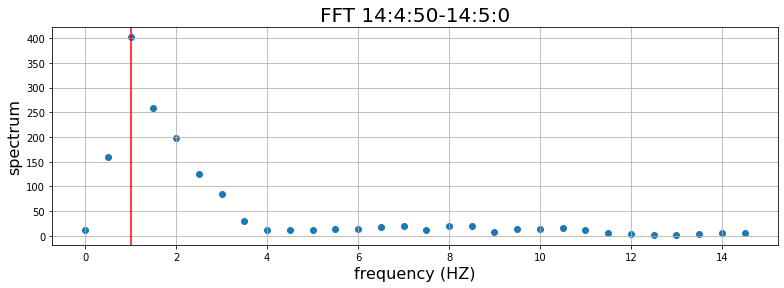

200000


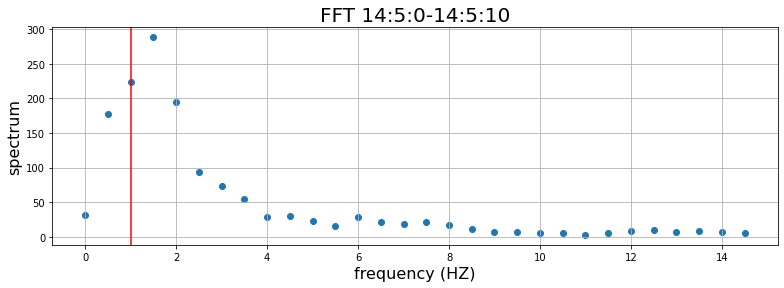

200000


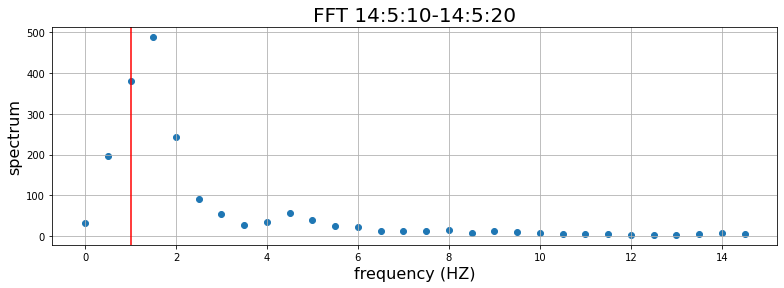

200000


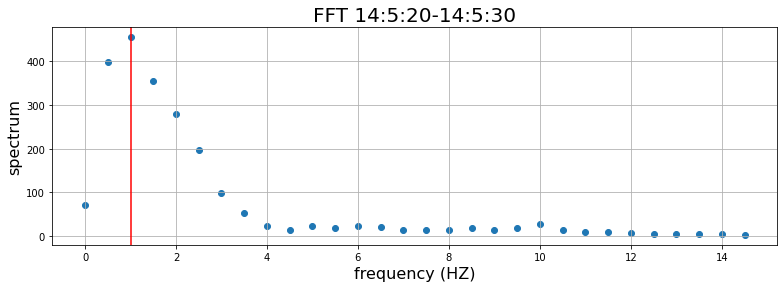

200000


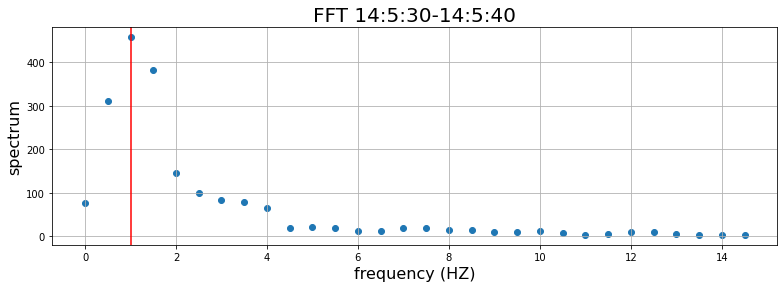

200000


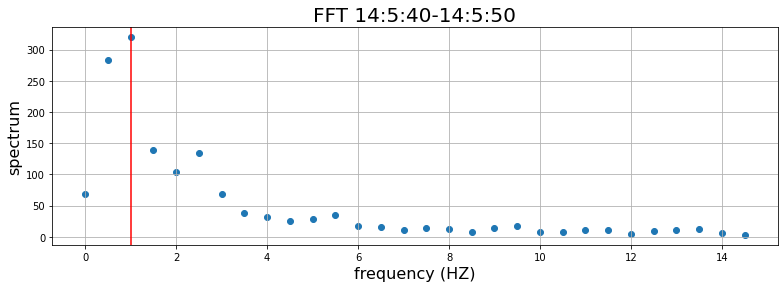

200000


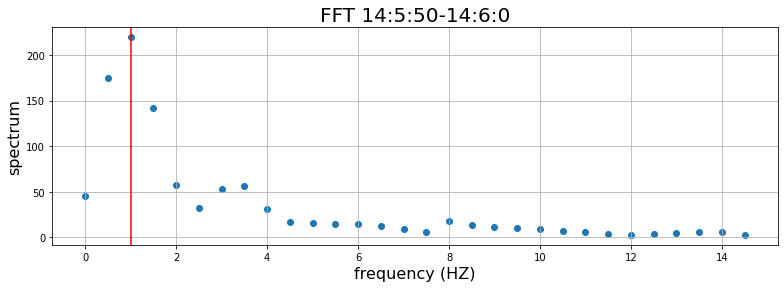

200000


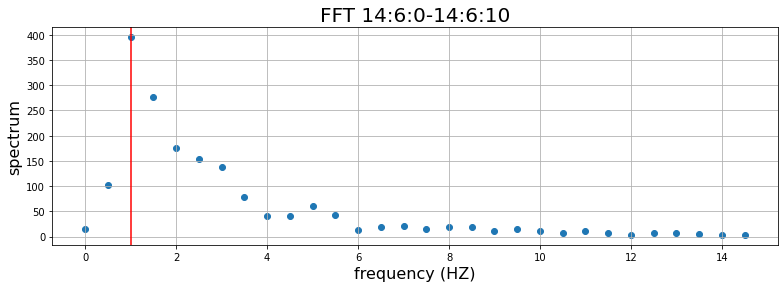

200000


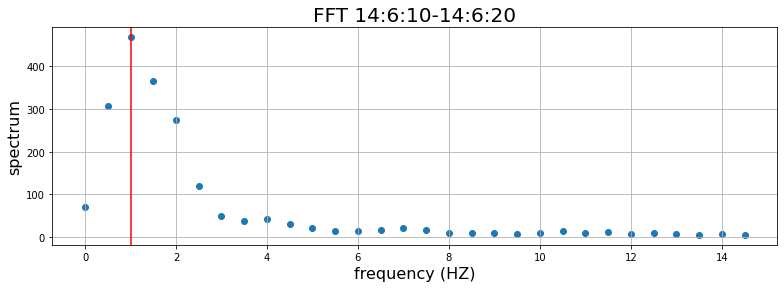

200000


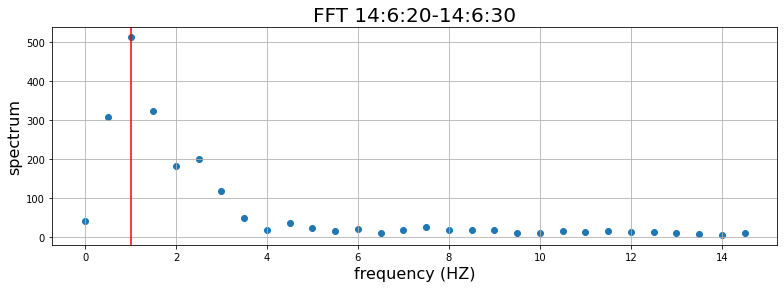

200000


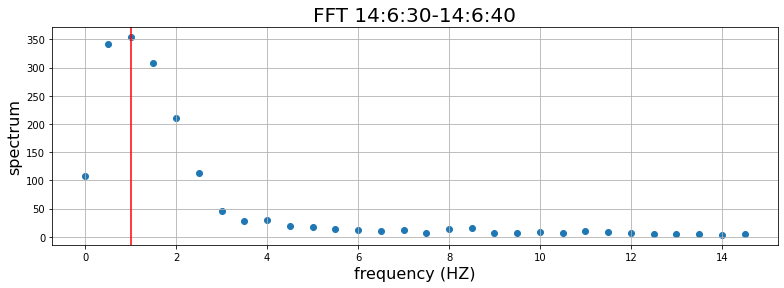

200000


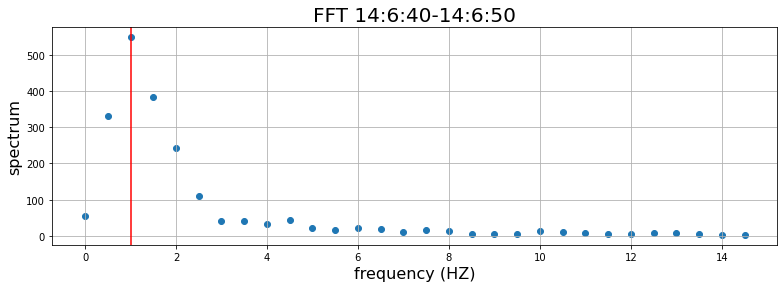

200000


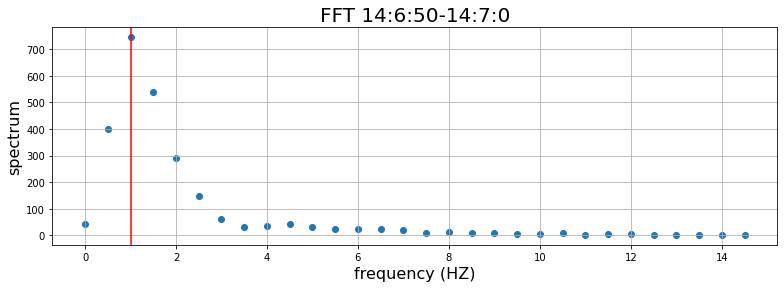

200000


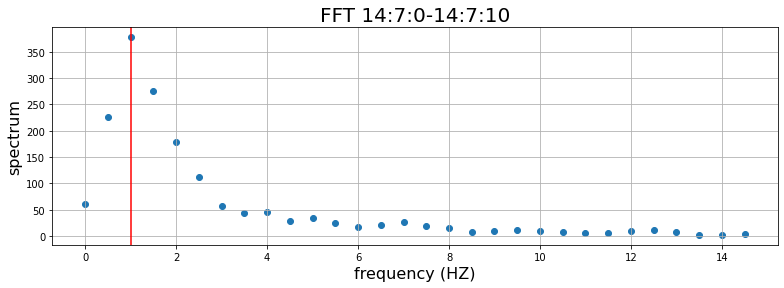

200000


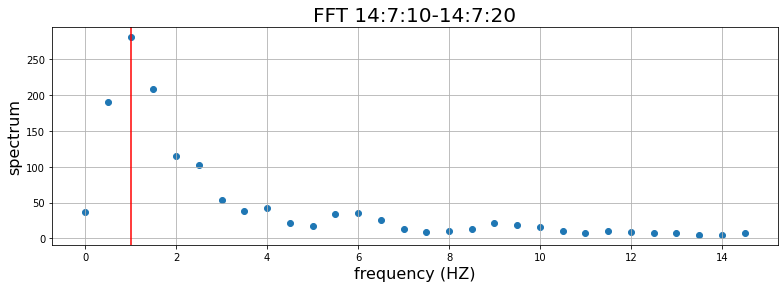

200000


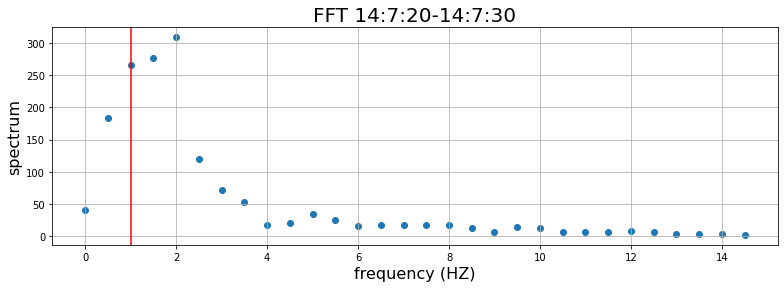

200000


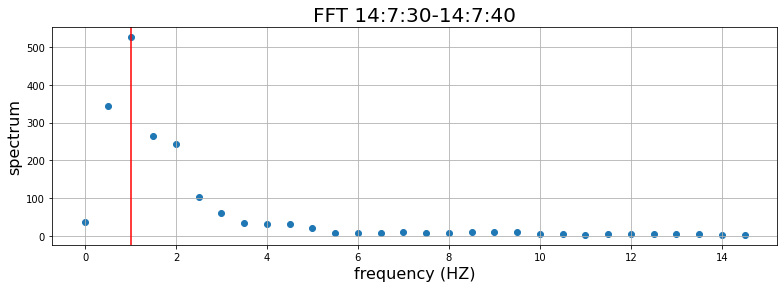

200000


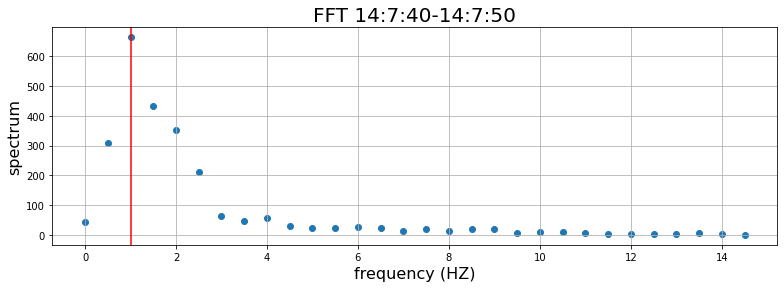

200000


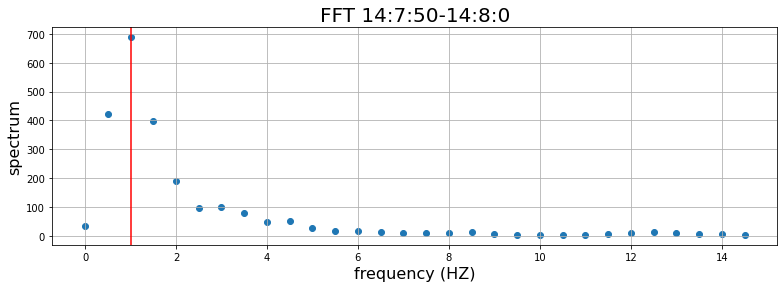

200000


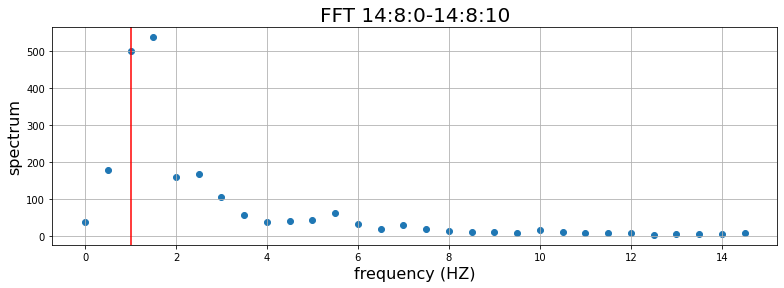

200000


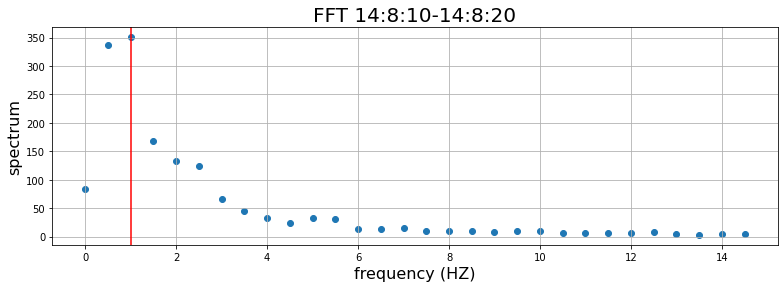

200000


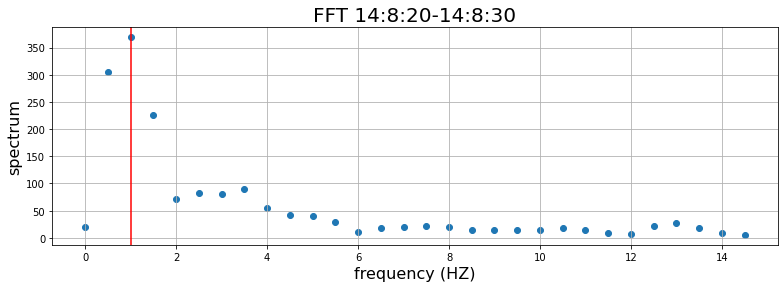

200000


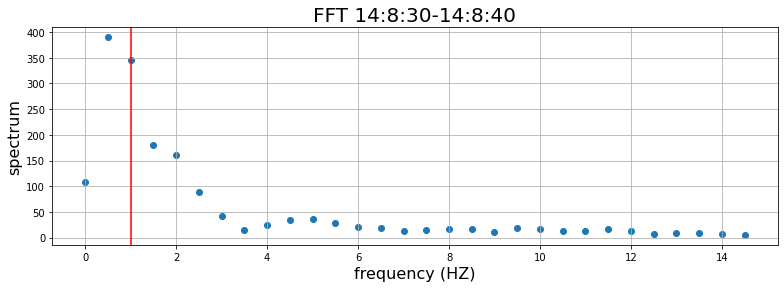

200000


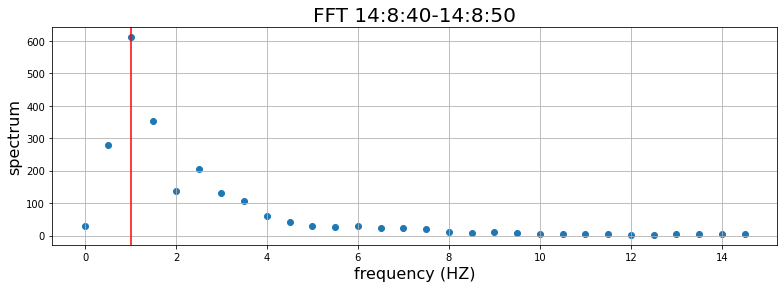

200000


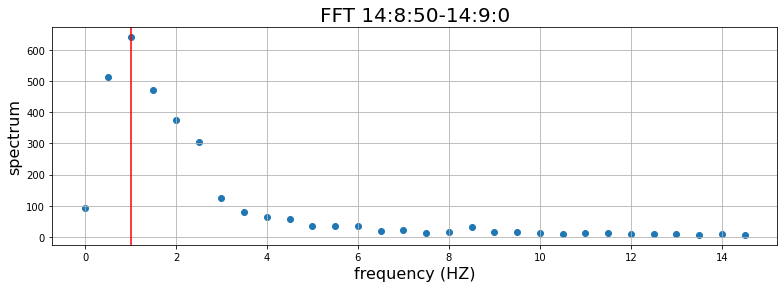

200000


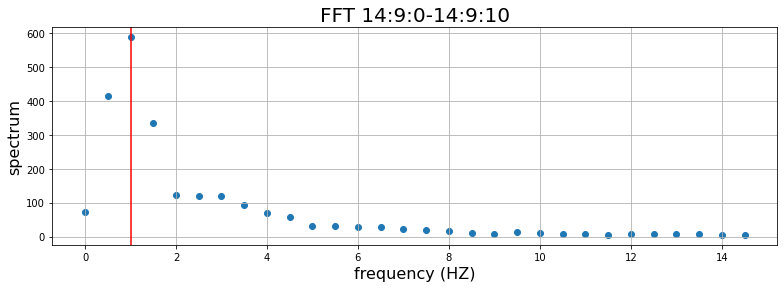

200000


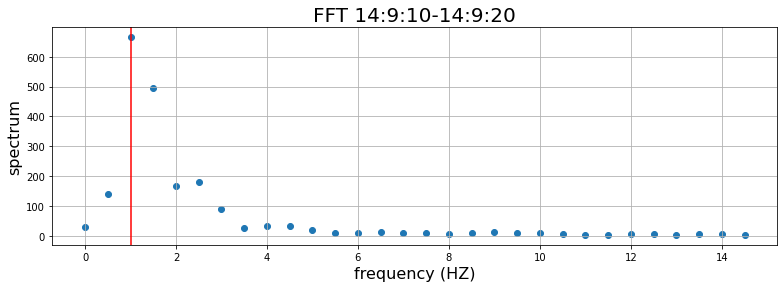

200000


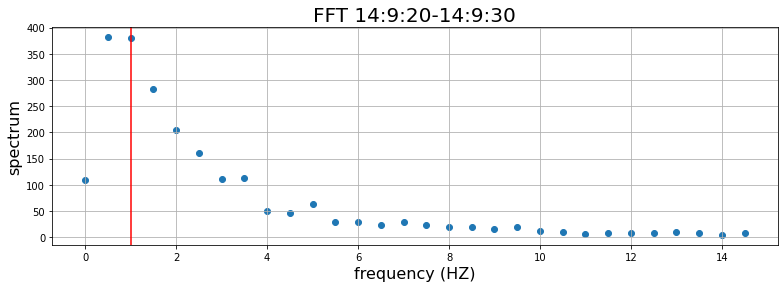

200000


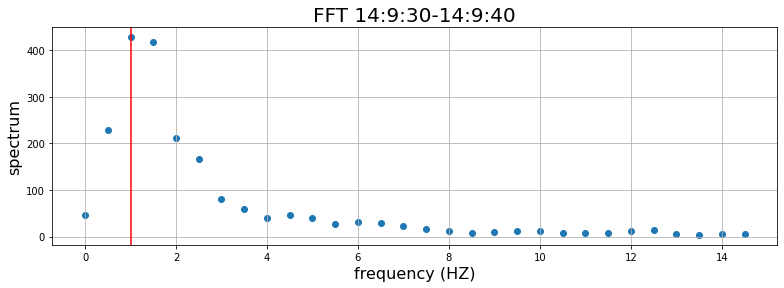

200000


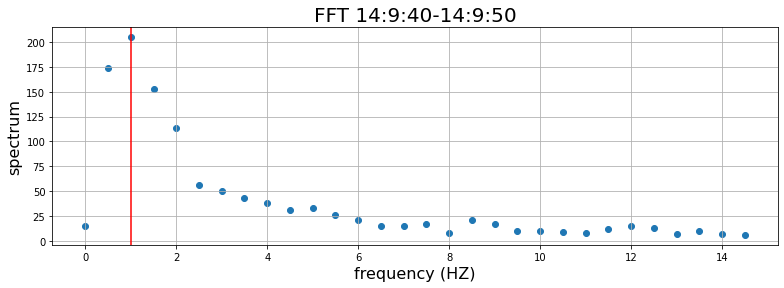

200000


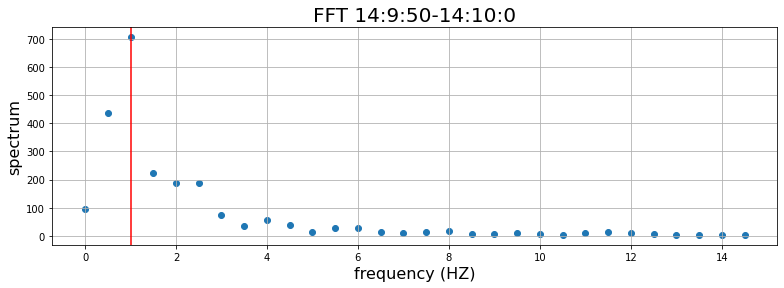

In [ ]:
strongest_frequency=[]
for i in range(0, 600, 10):
    data = data14[second_to_sample(i):second_to_sample(i+10)]
    print(data.size)
#     data = low_pass_filter(data)
    frequencies, density = signal.welch(data, fs=20000, nperseg=40000, noverlap=20000, scaling='spectrum')
#     print(frequencies[:30])
    strongest_frequency.append(frequencies[np.argmax(density)])
    plt.figure(figsize=(13,4))
    plt.scatter(frequencies[:30], density[:30])
    plt.grid()
    plt.title('FFT 14:%d:%d-14:%d:%d' %(i/60, i%60, (i+10)/60, (i+10)%60), fontsize=20)
    plt.xlabel('frequency (HZ)', fontsize=16)
    plt.ylabel('spectrum', fontsize=16)
    plt.axvline(x=1, color='r')
    plt.show()

1.1

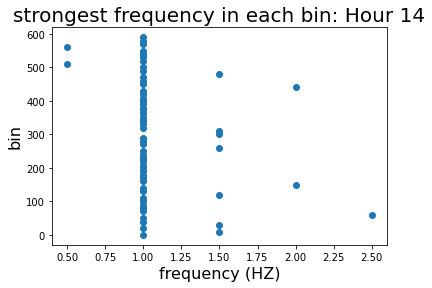

In [ ]:
plt.scatter(strongest_frequency, np.arange(0, 600, 10))
plt.title('strongest frequency in each bin: Hour 14', fontsize=20)
plt.xlabel('frequency (HZ)', fontsize=16)
plt.ylabel('bin', fontsize=16)
np.mean(strongest_frequency)

200000


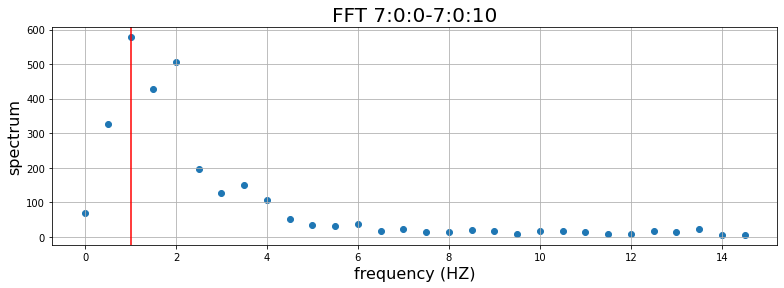

200000


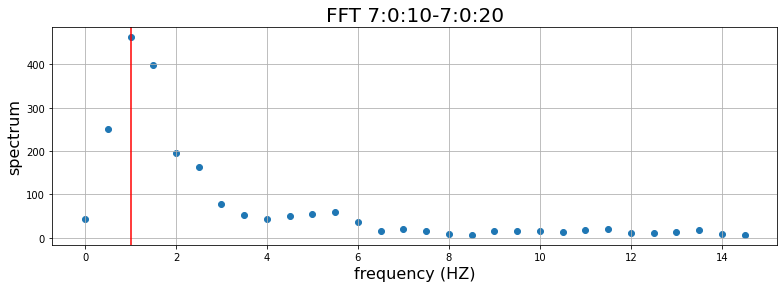

200000


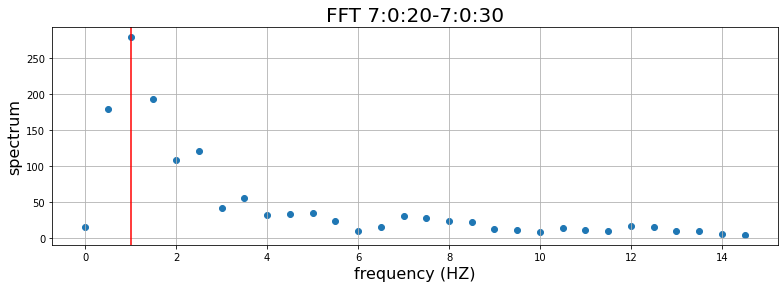

200000


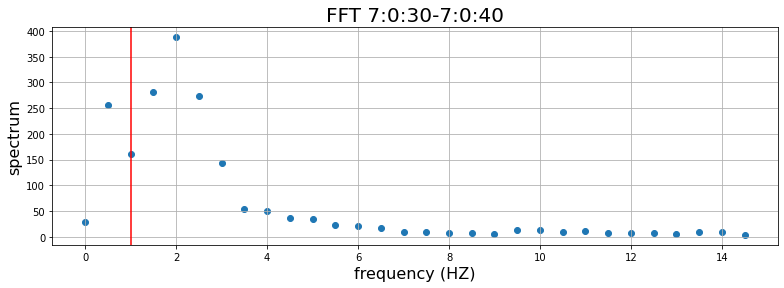

200000


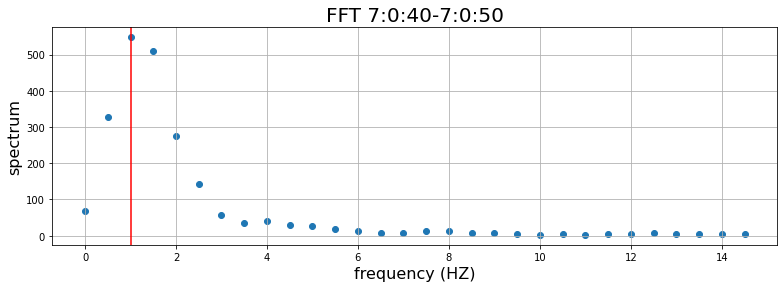

200000


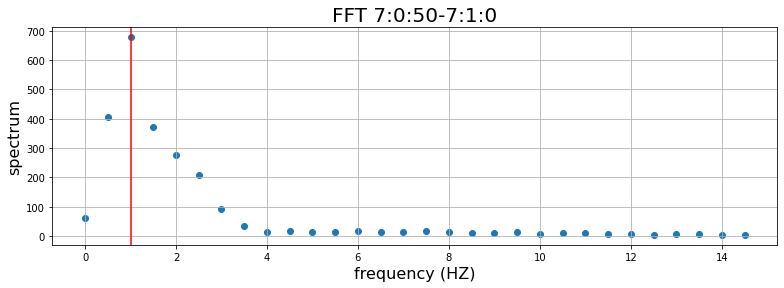

200000


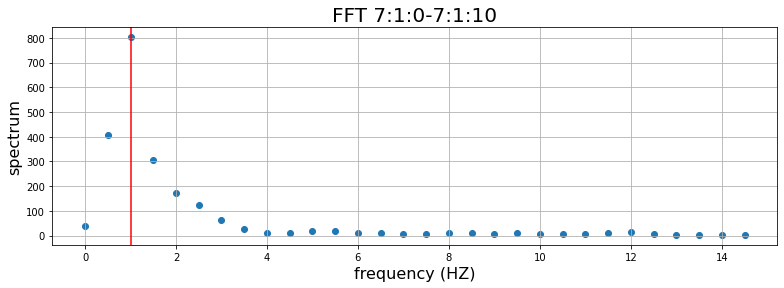

200000


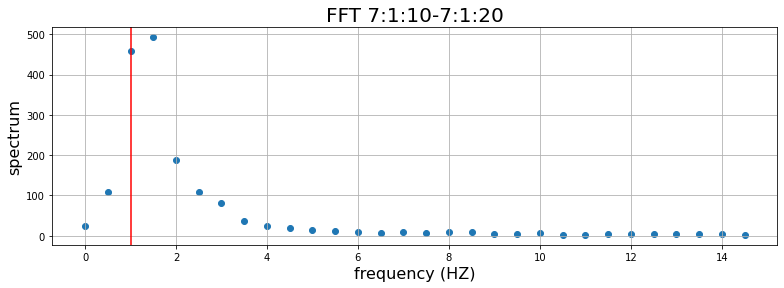

200000


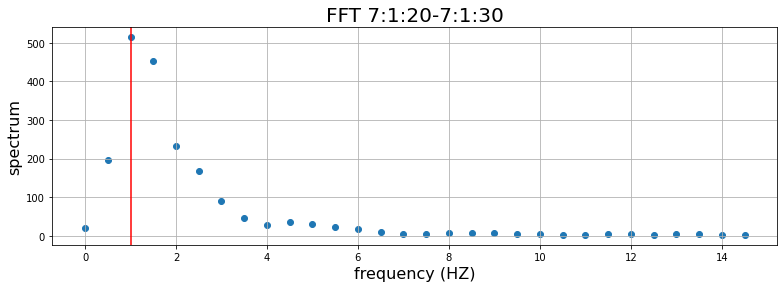

200000


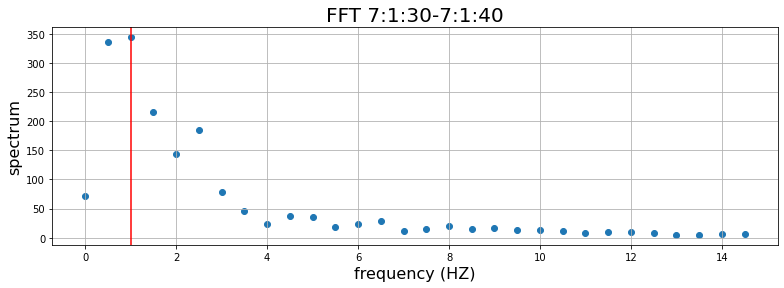

200000


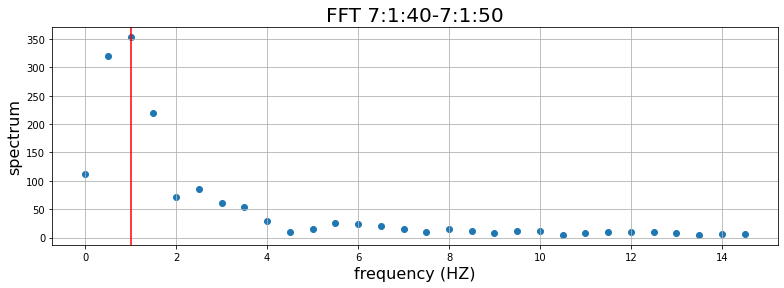

200000


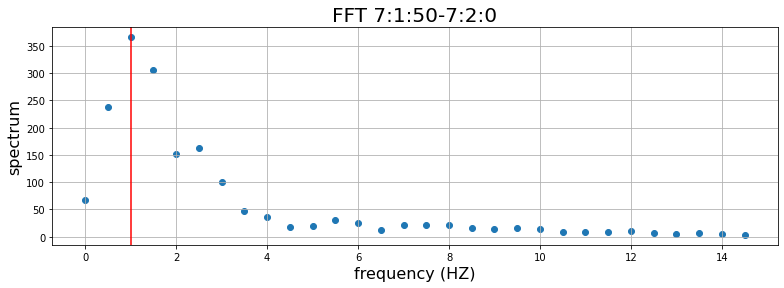

200000


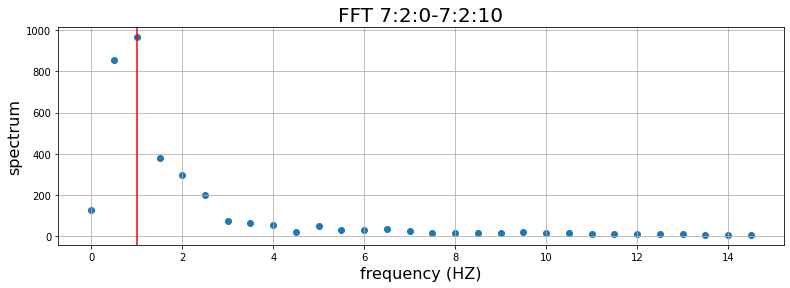

200000


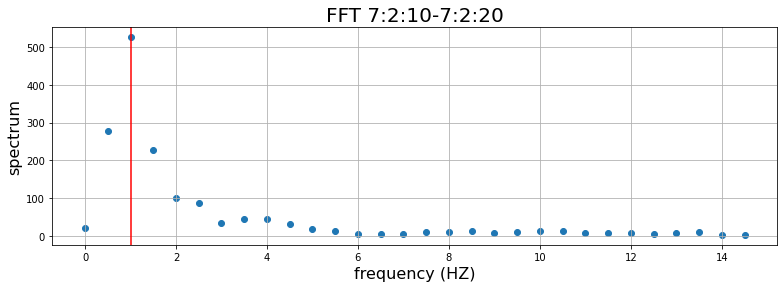

200000


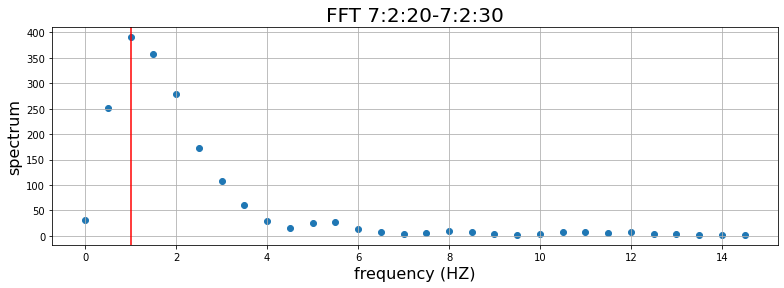

200000


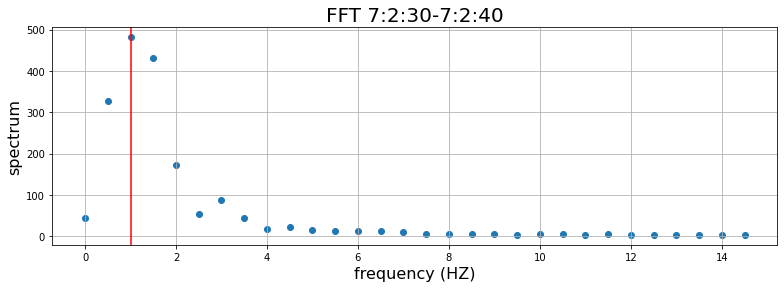

200000


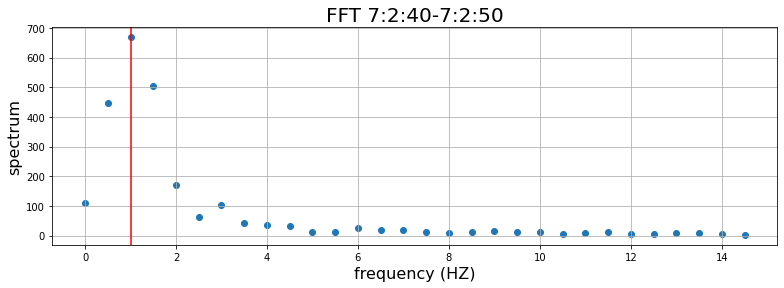

200000


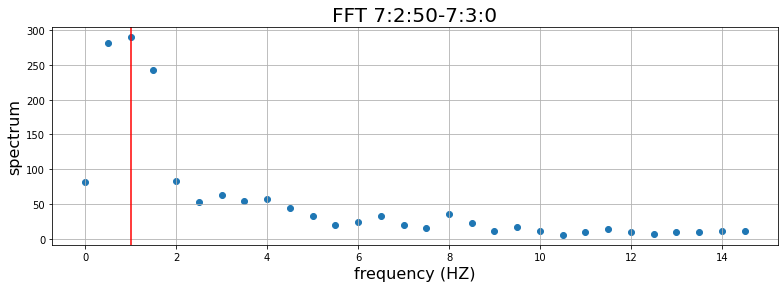

200000


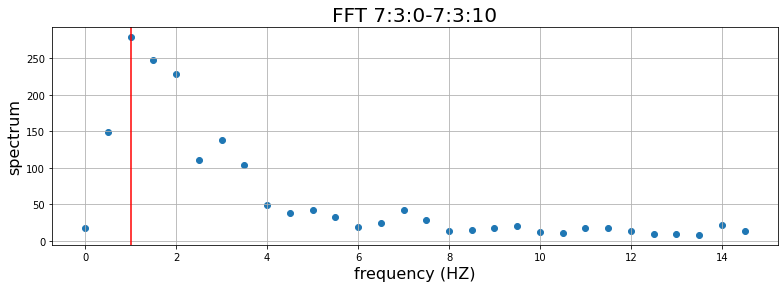

200000


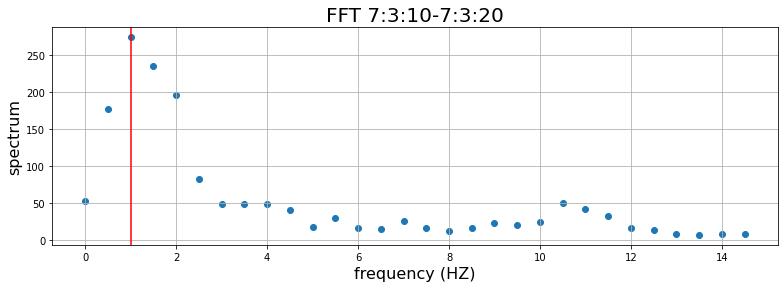

200000


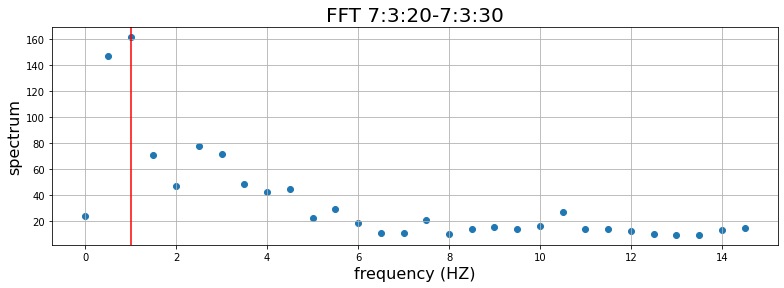

200000


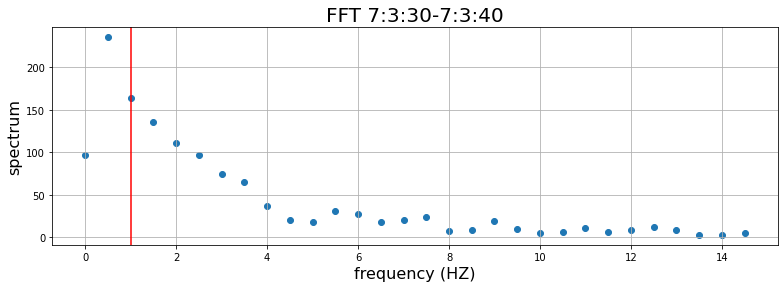

200000


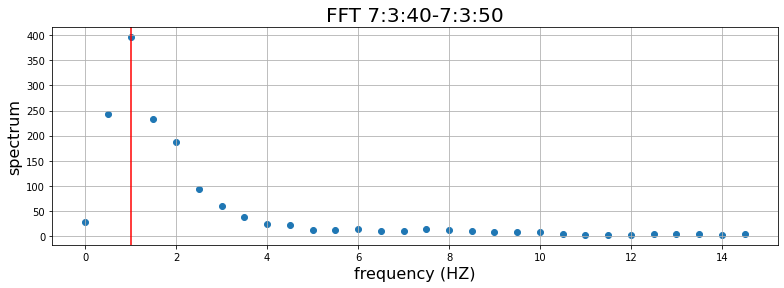

200000


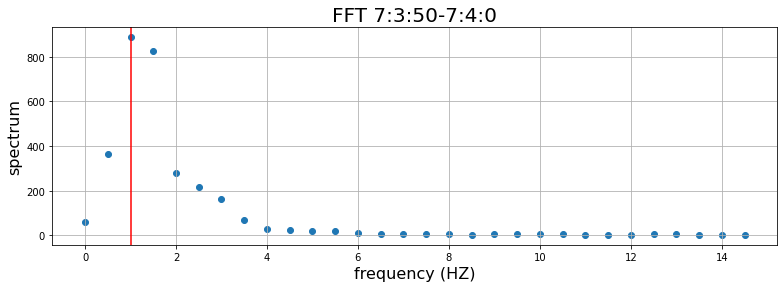

200000


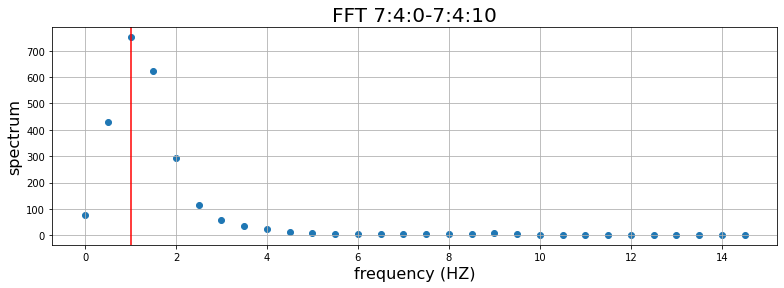

200000


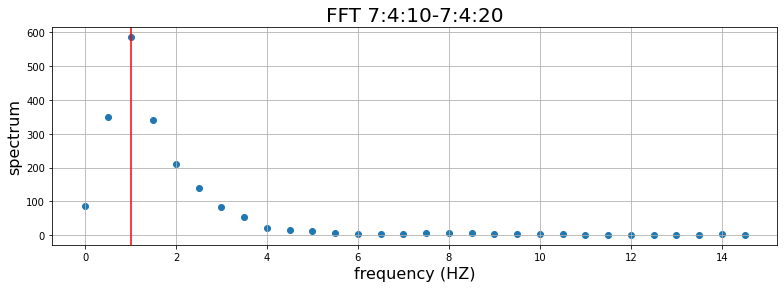

200000


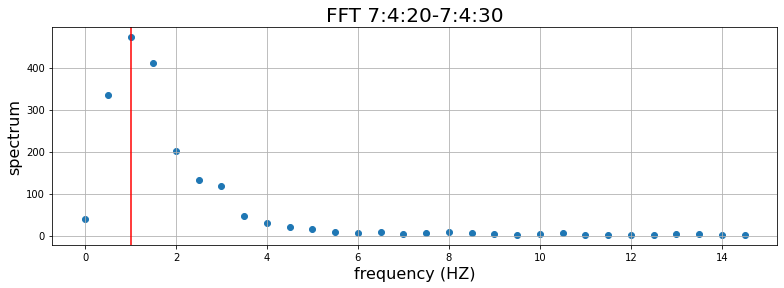

200000


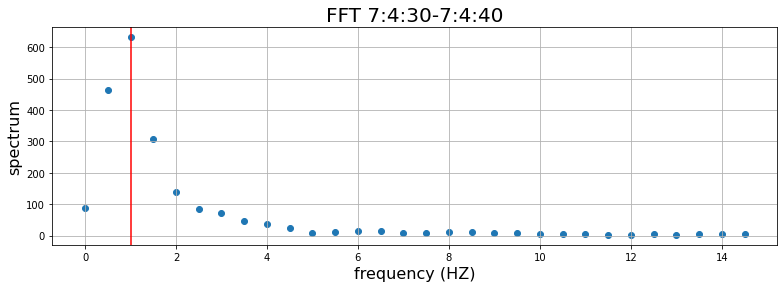

200000


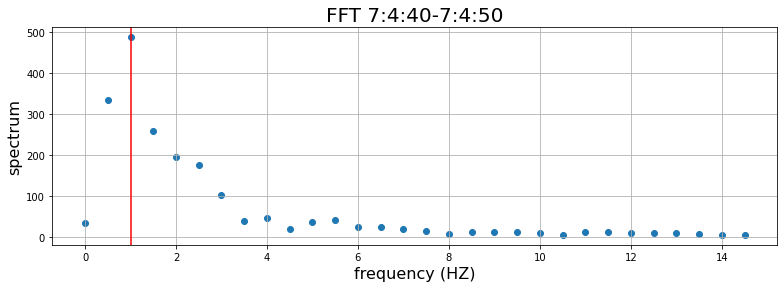

200000


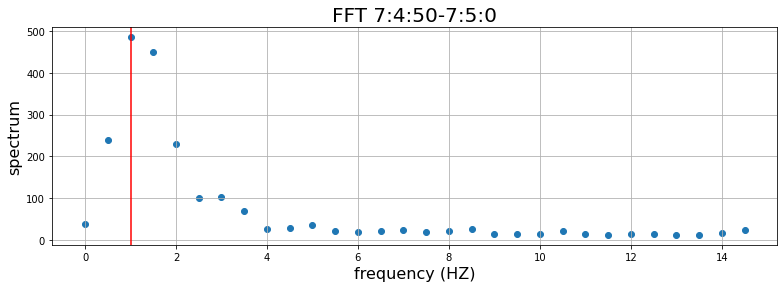

200000


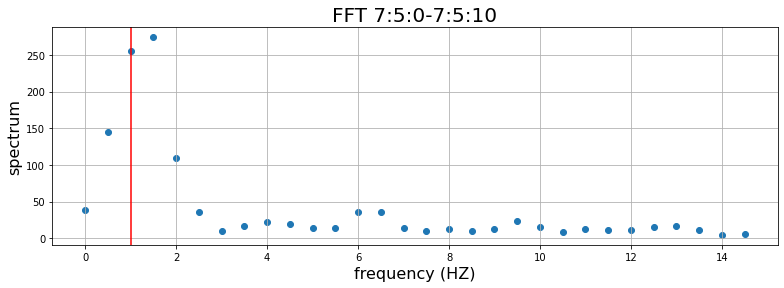

200000


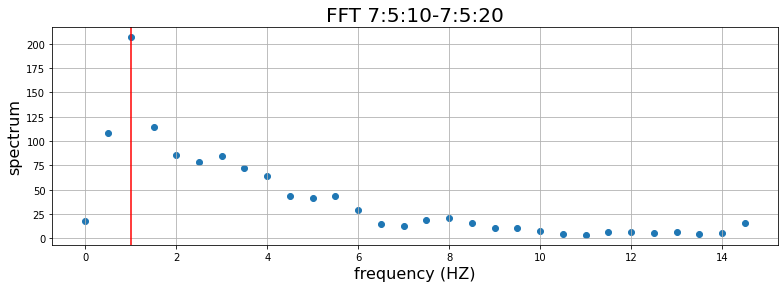

200000


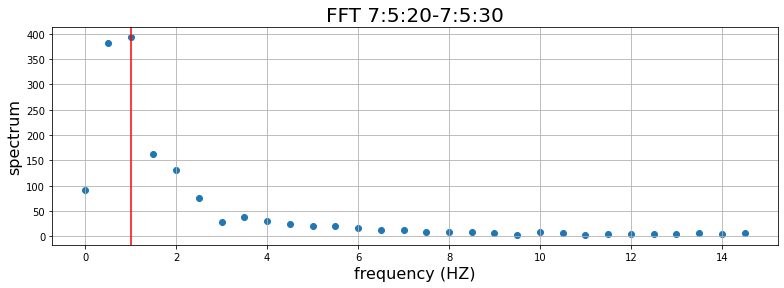

200000


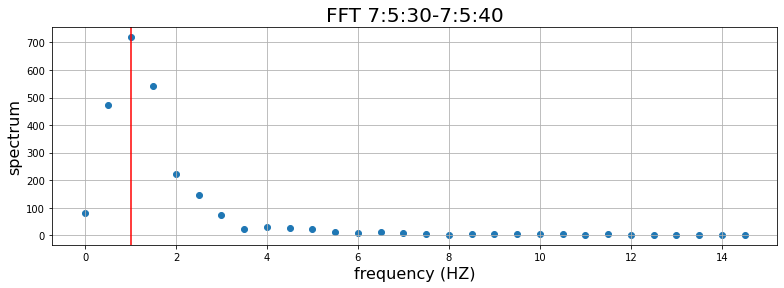

200000


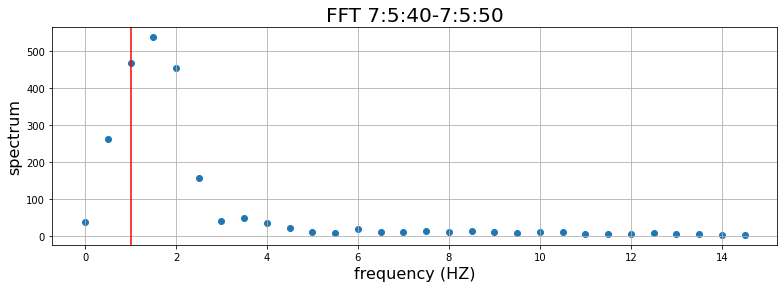

200000


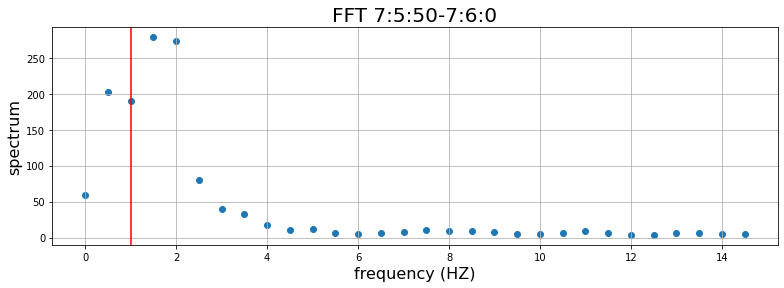

200000


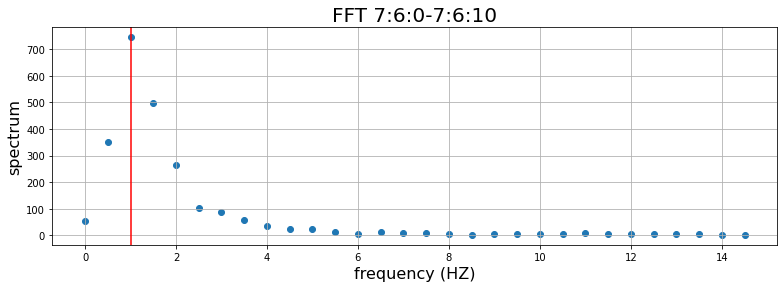

200000


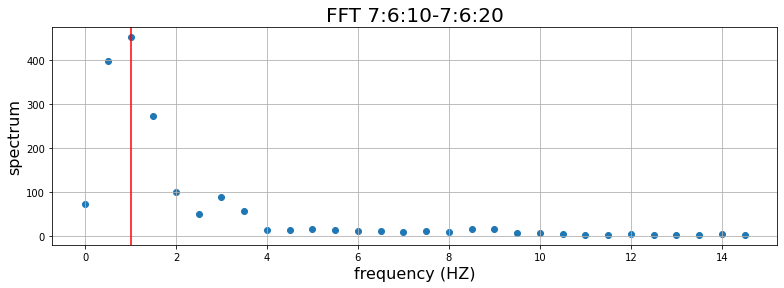

200000


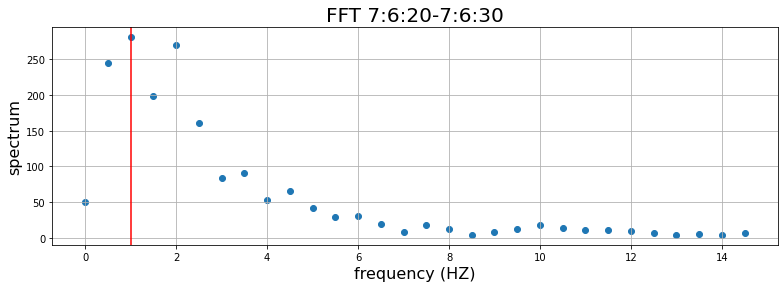

200000


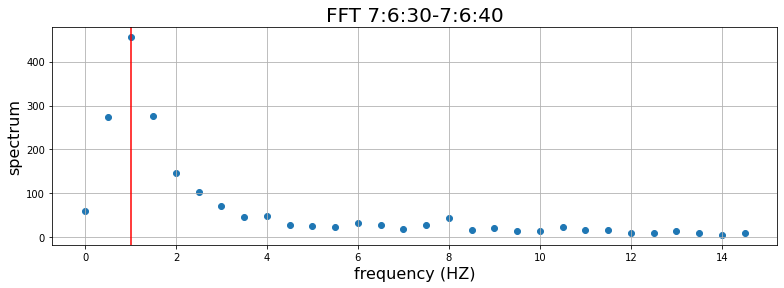

200000


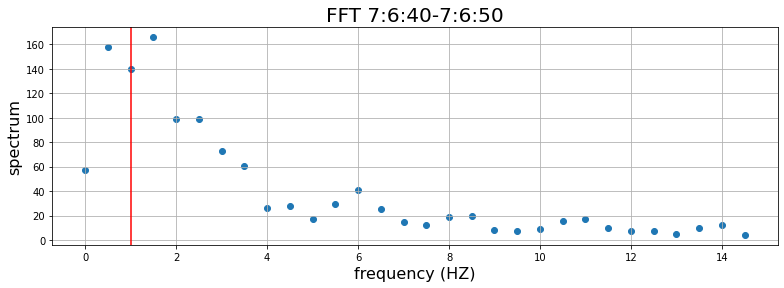

200000


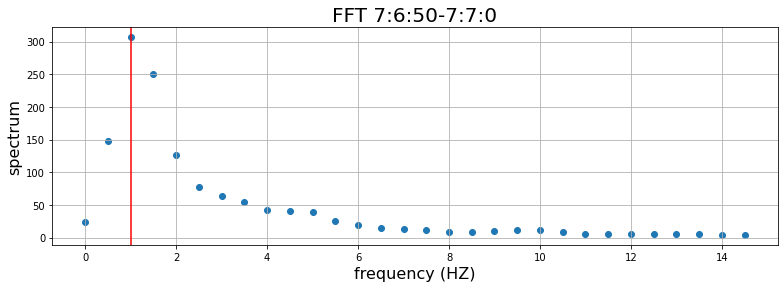

200000


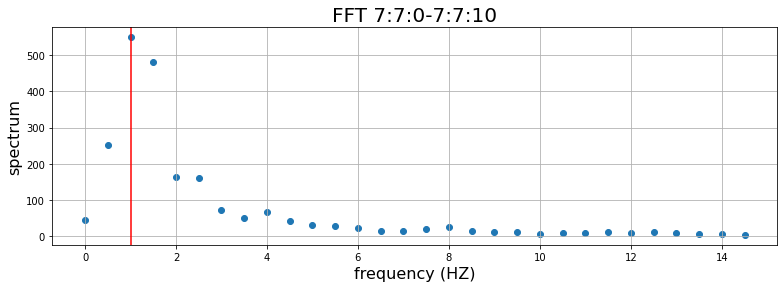

200000


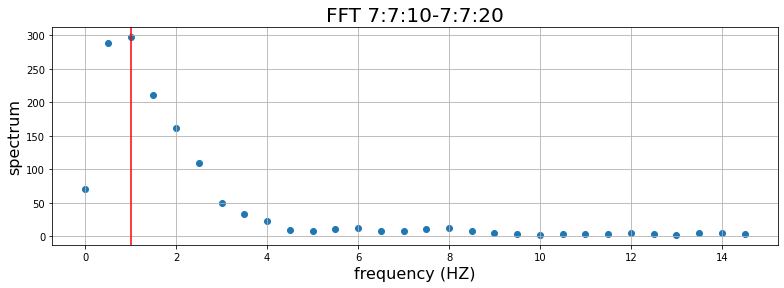

200000


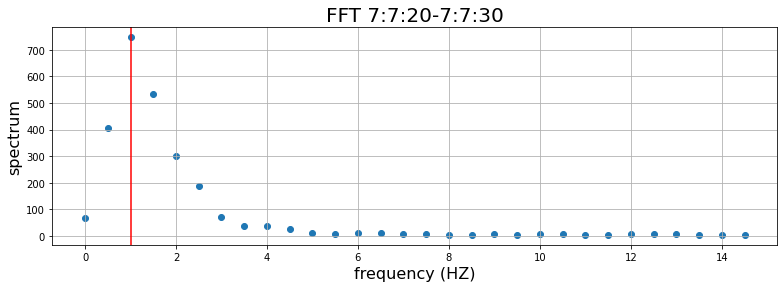

200000


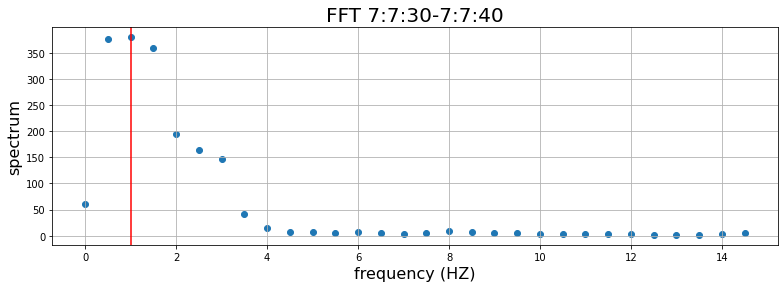

200000


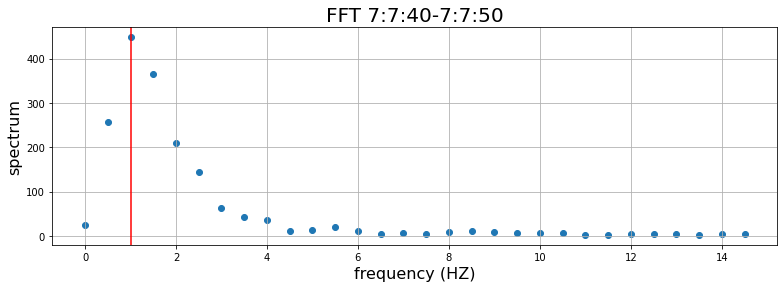

200000


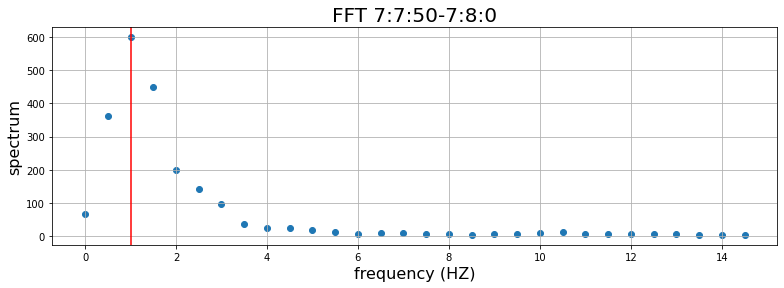

200000


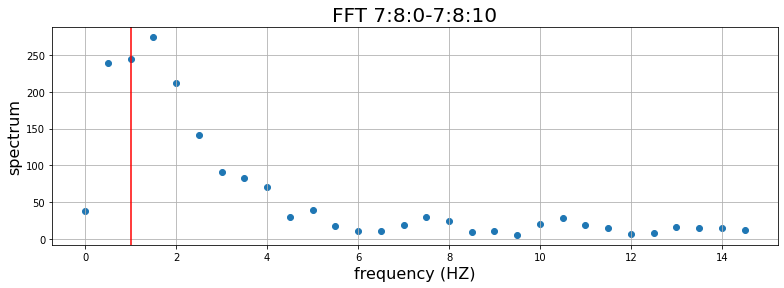

200000


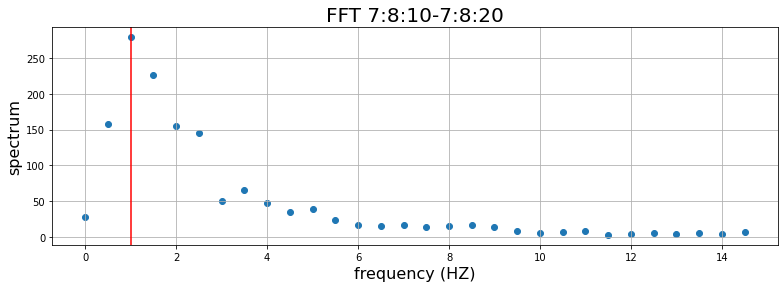

200000


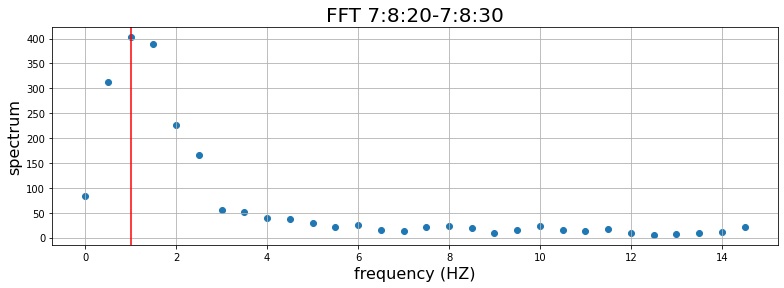

200000


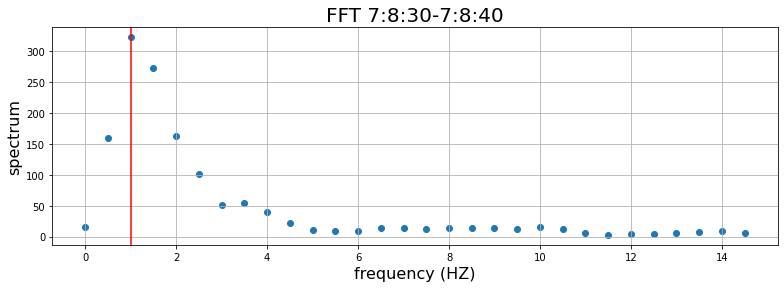

200000


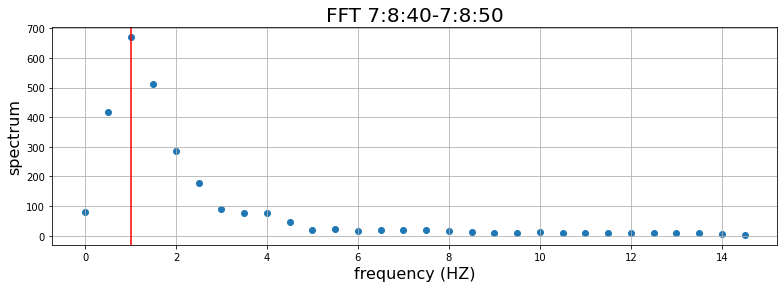

200000


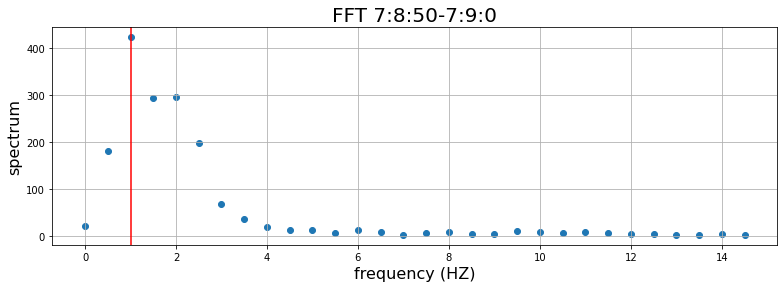

200000


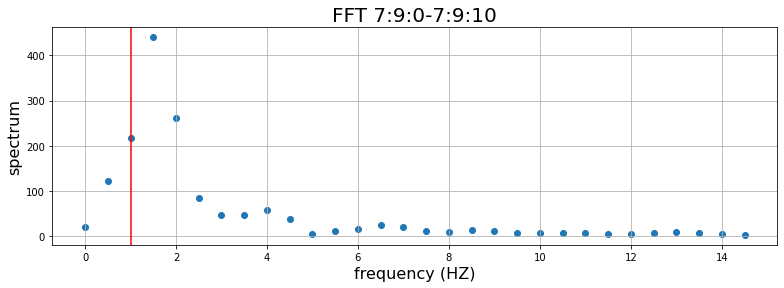

200000


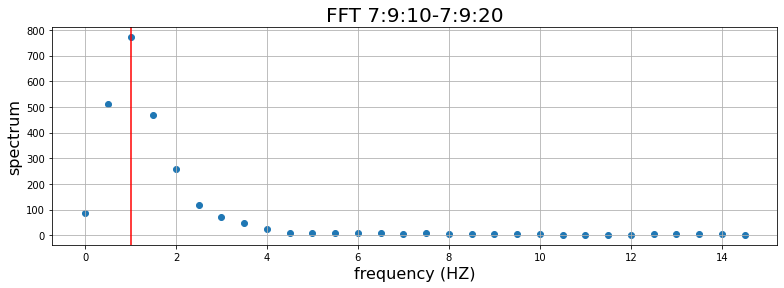

200000


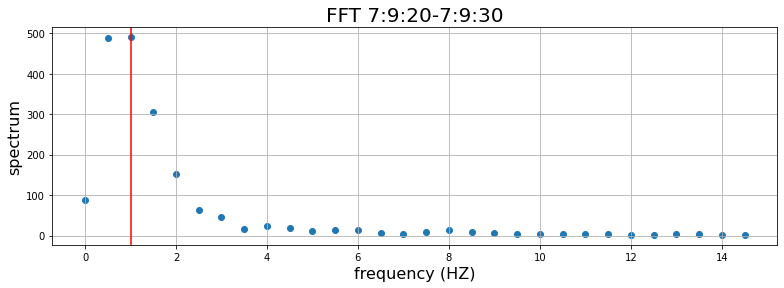

200000


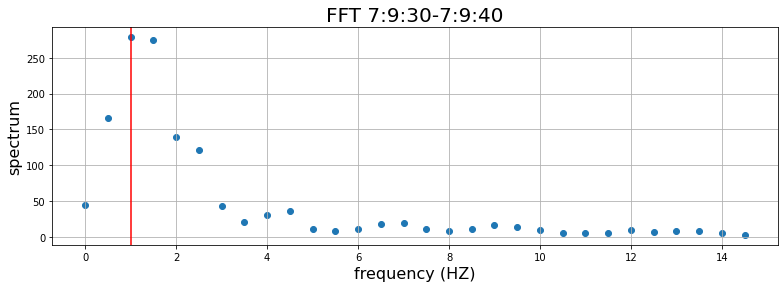

200000


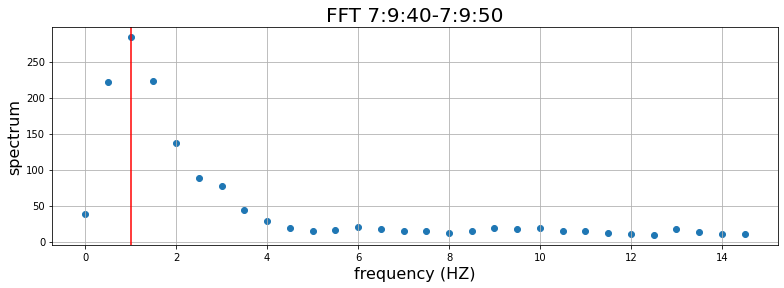

200000


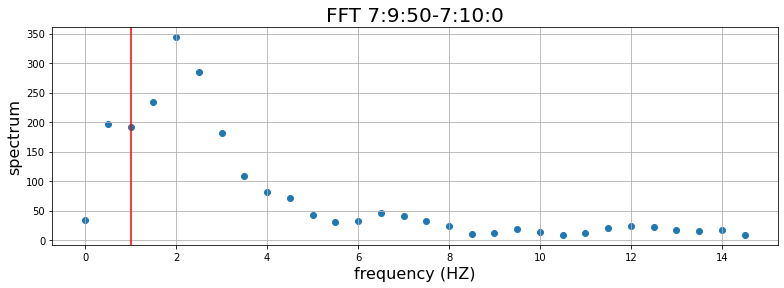

In [ ]:
strongest_frequency=[]
for i in range(0, 600, 10):
    data = data7[second_to_sample(i):second_to_sample(i+10)]
    print(data.size)
#     data = low_pass_filter(data)
    frequencies, density = signal.welch(data, fs=20000, nperseg=40000, noverlap=20000, scaling='spectrum')
#     print(frequencies[:30])
    strongest_frequency.append(frequencies[np.argmax(density)])
    plt.figure(figsize=(13,4))
    plt.scatter(frequencies[:30], density[:30])
    plt.grid()
    plt.title('FFT 7:%d:%d-7:%d:%d' %(i/60, i%60, (i+10)/60, (i+10)%60), fontsize=20)
    plt.xlabel('frequency (HZ)', fontsize=16)
    plt.ylabel('spectrum', fontsize=16)
    plt.axvline(x=1, color='r')
    plt.show()

1.0833333333333333

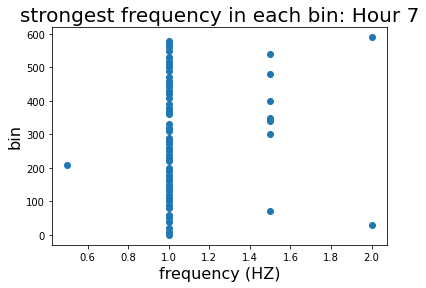

In [ ]:
plt.scatter(strongest_frequency, np.arange(0, 600, 10))
plt.title('strongest frequency in each bin: Hour 7', fontsize=20)
plt.xlabel('frequency (HZ)', fontsize=16)
plt.ylabel('bin', fontsize=16)
np.mean(strongest_frequency)

In [ ]:
magnitudes = np.zeros(16*60)
print(magnitudes.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=40000, noverlap=20000)
    print(freqs[2])
    magnitudes[hour*60:(hour+1)*60] = spect[:,2]
    print(magnitudes[hour*60:(hour+1)*60])

960
data.size = 72000000
1.0
[ 223.98273687  433.90572783  430.06275672  493.09516496  378.40203443
  494.37879445  548.97533971  412.52682986  451.90219257  513.25644323
  472.26588782  661.003499    398.36795684  715.95445888  391.35627563
  529.92745154  388.32569412  385.27008573  543.97512021  331.14274134
  593.31119369  584.02470892  472.95598282  337.49719655  308.74177328
  406.91208756 1153.64569662  473.56041515 3217.13909197  521.79007972
  372.68933902  357.13202626  402.21595135  536.99636387  631.88548045
  679.03546498  661.14291886  547.28569108  635.93544701  551.95991681
  739.59988841  607.37762912  710.06573858  616.1870984   449.55679926
  505.85885962  630.33653697  533.94873759  546.91333513  590.88117988
  572.59568072  678.40140644  665.33801407  583.33327733  523.48422149
  754.43260665  546.73427075  651.32830003  632.03840437  677.39277409]
data.size = 72000000
1.0
[539.00324978 628.53652128 716.20553354 564.77065237 650.9427261
 613.02589446 659.01876083 6

data.size = 72000000
1.0
[352.10487587 346.81255047 409.12336226 391.33373535 345.41796547
 449.0666151  310.04600773 360.00793592 558.95538564 373.45664499
 437.04437549 501.95701945 281.12517428 567.64265426 345.32587314
 533.21817072 238.79382327 404.73291665 310.9001794  480.43107476
 495.13330005 422.53586037 572.42218893 327.96870703 529.97149996
 495.95777548 460.66213536 335.04368365 526.93434261 309.13223086
 426.29102905 337.28917379 397.88806859 467.52980836 330.98261718
 428.49711827 326.31827542 459.02514841 366.5316651  415.85870751
 544.67635623 198.56717216 333.79270636 365.12749794 508.62568486
 383.2613617  291.41415943 380.51281435 432.42887596 230.16955798
 438.91700652 514.38464116 368.54787028 486.39458486 464.95168963
 267.54700085 431.47155486 324.70057508 395.54385475 323.40680837]
data.size = 72000000
1.0
[511.38151933 325.14298189 415.95415731 380.43112416 313.30460442
 270.63866675 450.29181797 220.3018724  452.79955156 429.83357602
 404.85760836 405.279861 

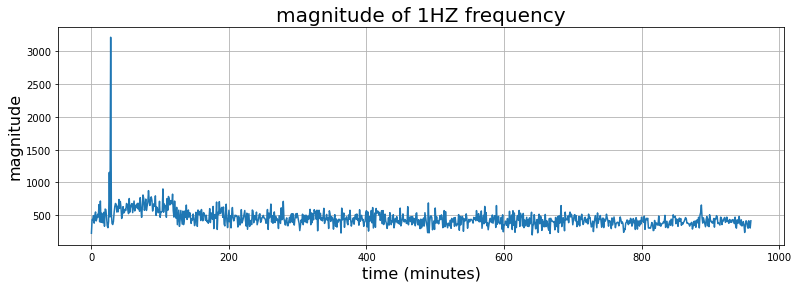

In [ ]:
plt.figure(figsize=(13,4))
plt.plot( np.arange(16*60), magnitudes)
plt.grid()
plt.title('magnitude of 1HZ frequency',fontsize=20)
plt.xlabel('time (minutes)', fontsize=16)
plt.ylabel('magnitude', fontsize=16)
plt.show()

In [ ]:
magnitudes3 = np.zeros(16*60)
print(magnitudes3.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=40000, noverlap=20000)
    print(freqs[6])
    magnitudes3[hour*60:(hour+1)*60] = spect[:,6]
    print(magnitudes3[hour*60:(hour+1)*60])

960
data.size = 72000000
3.0
[ 76.86571579 102.60758225  95.22136682  81.9359596   98.05276596
 122.16072945 117.72413706 109.11252597 133.34044093 157.62054845
 137.51029216 119.87705275 117.90131719  94.49252363 125.74452059
 105.27302342 140.91340042 101.50625181 161.56562639  74.08137963
 135.91564639 117.9423564  112.03777029  74.28670396 101.36636974
 123.37425219 187.08844489 304.92543736 796.54436766 266.86283312
 103.52009881  84.51059008 108.77961704 102.63303104 131.26852052
 108.07992016 126.85234517 110.49200361 115.31008062 103.39857656
 114.90545448 161.62260411 137.94654725 109.47250641 119.79745761
 130.57090219 138.6737948   83.4435705  104.12184534 126.72436306
 115.35830527 113.09292099 111.61816987 118.90899474 121.39704554
 154.77699946 129.67144412 123.8884241  159.30285072 124.01790209]
data.size = 72000000
3.0
[149.19602487 141.79616444 126.84813681 131.33057107 129.99779466
 111.05494069 132.8324149  130.52782286 157.68389742 153.66290479
 112.17655574 148.090

data.size = 72000000
3.0
[ 71.74303326  49.32620885  74.09697235  79.50755842  66.0152249
  75.68990613  81.47601979  54.19496029  65.8496336   82.06385115
  64.45068826  87.58203287  85.88041169  54.24007531  64.71303607
  88.27089616  69.68957511  61.35938599  80.80540373  65.14767228
  52.97876052  59.95594456  81.76738028  71.33242919  72.75651896
  62.140576    68.15000512  79.89305763  46.51161152  64.78631971
  76.16950001  58.33431358  70.41180856  63.33631058  69.91792046
  91.27952096  77.73103653 113.09980023  81.03452829  66.88087955
  63.50858594  88.51999613  99.21757309  89.20025854  94.48920076
  78.55440929  80.4793646   63.81180927  76.38208602  68.91524651
  80.65566043  77.47948095  73.81483154 100.04049519  73.40115756
  64.38262945  67.85535901  70.85286412  66.58227666  56.1316993 ]
data.size = 72000000
3.0
[ 93.67855849 100.48459455  76.75090684 100.90889892  80.45223875
  72.51344949  85.5391229   77.34945868  69.14462     73.2107575
  80.86963997  82.61840047 

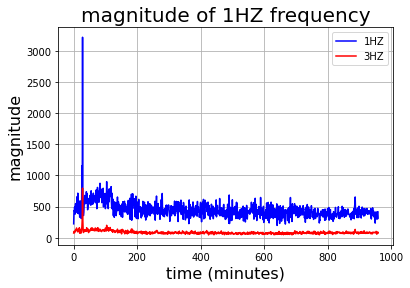

In [ ]:
plt.plot(np.arange(16*60), magnitudes, 'b-', label='1HZ')
plt.plot(np.arange(16*60), magnitudes3, 'r-', label='3HZ')
plt.legend(loc='best')
plt.grid()
plt.title('magnitude of 1HZ frequency',fontsize=20)
plt.xlabel('time (minutes)', fontsize=16)
plt.ylabel('magnitude', fontsize=16)
plt.show()

In [ ]:
magnitudes10 = np.zeros(16*60)
print(magnitudes10.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=40000, noverlap=20000)
    print(freqs[20])
    magnitudes10[hour*60:(hour+1)*60] = spect[:,20]
    print(magnitudes10[hour*60:(hour+1)*60])

960
data.size = 72000000
10.0
[ 11.40618006   8.84827877   7.45683907   7.35537846   7.79140578
   7.67142378  10.61396482   9.11712018   9.19116034   8.50307256
   8.75061465   8.69224558   9.71264335   8.76738228  12.24500856
   8.18366914  10.31143761  10.1555135   11.37451665  10.8059102
   7.48269658  10.74960856   9.61824611  12.63598454  17.61595551
  15.08966329  17.13018336  48.31613362  65.51764388 111.67143016
  12.57537374   6.77957292   9.94440526   8.28302363   9.30946898
  12.266396     8.65946224   9.98634251   8.44957404   8.59768872
  10.34617867   9.77744615   8.71977609  10.67531655  13.27349794
  10.33875401   8.48323157  10.4834679   10.41389011   9.47985246
  10.28689712   8.23066192   7.81474785  10.71887241  10.90996718
  11.1350764   10.8306998   12.09595693  12.3976904   13.27557957]
data.size = 72000000
10.0
[12.62353994 13.094857   11.58139009 12.62525291 10.71291294 13.34633873
 12.11211058 16.7581945  11.86172201 13.15952865 13.27389054 11.31714834
  9.58

data.size = 72000000
10.0
[10.8203769  15.10188183  6.97146413  9.57934384 10.67652845 13.316828
  6.36272947 11.60488595 16.75315506 11.71397005  9.58020088 11.64715265
 12.48985698 10.76174356 11.52375806  7.4437022   9.32658756 11.50880104
  8.97059342 12.5461074   9.26786958  9.30254631 17.27865506  8.84520106
 11.58575992  9.23967275  9.85456698  9.42006892  9.80385354  6.80655086
  8.96285971 10.03659337  9.14924533  9.08942162 13.33169325 12.43075515
 10.82796423 13.4390025   9.67571833  7.20753107 11.47984939 13.19642869
 12.86681734 11.83725619 11.01378606 10.4875142   9.46192467 10.35999269
  9.39106885 10.46911247 11.87748605  7.66185471 12.5234561   9.18266327
  9.36524949 13.04105621 10.23663272 10.38921528  7.97114451 14.25482511]
data.size = 72000000
10.0
[10.62495163 10.09381196 13.16199969 11.11318568  8.77136644 11.50523463
 10.88355134 13.61849711  9.424667   11.75370607 12.18075617  9.42312047
 10.12656791  9.70192475  8.21976906 10.52915151  8.87070268 11.05676403


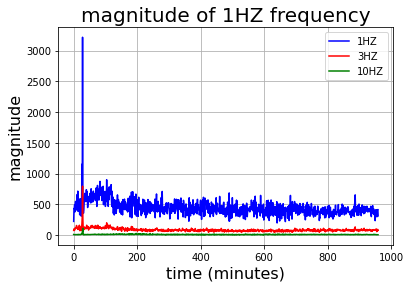

In [ ]:
plt.plot(np.arange(16*60), magnitudes, 'b-', label='1HZ')
plt.plot(np.arange(16*60), magnitudes3, 'r-', label='3HZ')
plt.plot(np.arange(16*60), magnitudes10, 'g-', label='10HZ')
plt.legend(loc='best')
plt.grid()
plt.title('magnitude of 1HZ frequency',fontsize=20)
plt.xlabel('time (minutes)', fontsize=16)
plt.ylabel('magnitude', fontsize=16)
plt.show()

In [ ]:
magnitudes05 = np.zeros(16*60)
print(magnitudes05.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=40000, noverlap=20000)
    print(freqs[1])
    magnitudes05[hour*60:(hour+1)*60] = spect[:,1]
    print(magnitudes05[hour*60:(hour+1)*60])

960
data.size = 72000000
0.5
[ 154.12542156  190.4924161   201.7260919   267.9551421   208.33900503
  173.31328142  288.45927674  215.08716423  248.24867002  239.11386161
  223.58959404  410.22188558  257.83648127  282.06281941  184.27275466
  295.12240475  237.63852922  227.82884577  223.81187556  149.18539886
  326.44004162  285.43243493  279.12464596  222.21068219  289.77651204
  344.88270101 2090.12251817  621.85407622 4101.24097645  597.46786795
  198.4181272   163.4455474   211.83543897  335.38633343  357.37638848
  353.65337064  283.85548809  303.75189147  309.97733836  275.57755839
  382.66504394  364.69870003  354.49181931  322.86987723  259.23371903
  275.61149476  337.07249599  250.11156069  352.70638892  249.97616012
  272.30847547  384.85527916  375.32359298  362.3988251   297.28985845
  401.83852288  323.15559233  316.11311439  379.34823659  376.77073944]
data.size = 72000000
0.5
[367.61791264 363.40370484 382.94108784 369.23608801 352.33474889
 345.69114434 418.5535906  

data.size = 72000000
0.5
[266.87710462 214.61699759 182.03972127 200.04644259 229.71855518
 233.52547284 203.57732733 199.9161929  269.1158092  210.34598822
 230.99629307 267.96824635 188.63650392 330.01778675 228.35343734
 326.19060321 147.80959033 280.75330971 172.92897765 349.26483261
 326.70869586 287.8823791  361.55355016 211.59734018 307.67147705
 328.97867422 294.45032118 228.69142834 236.48301419 188.93523074
 311.9804808  261.42195224 247.56467648 273.71891828 211.01588359
 328.90679592 210.21836806 231.31528577 226.14258148 268.31427293
 335.69091608 165.27118207 240.94033528 245.44483028 256.83548698
 240.54450993 157.55389823 213.58077095 354.63836741 185.81924716
 288.46405688 355.73738512 277.74536233 298.40332751 257.63321412
 184.20209214 230.97044227 214.46305828 222.97013128 217.5181486 ]
data.size = 72000000
0.5
[293.9696226  189.64151896 235.49887484 245.7038328  215.88115161
 211.21767898 301.56397152 207.52312181 242.32166786 314.56863334
 211.00089192 256.8616497

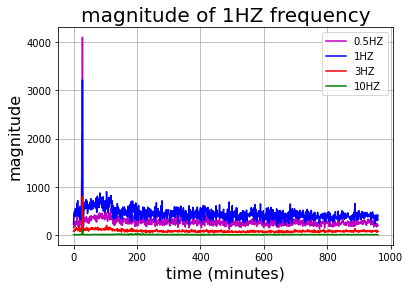

In [ ]:
plt.plot(np.arange(16*60), magnitudes05, 'm-', label='0.5HZ')
plt.plot(np.arange(16*60), magnitudes, 'b-', label='1HZ')
plt.plot(np.arange(16*60), magnitudes3, 'r-', label='3HZ')
plt.plot(np.arange(16*60), magnitudes10, 'g-', label='10HZ')
plt.legend(loc='best')
plt.grid()
plt.title('magnitude of 1HZ frequency',fontsize=20)
plt.xlabel('time (minutes)', fontsize=16)
plt.ylabel('magnitude', fontsize=16)
plt.show()

In [ ]:
magnitudes = np.zeros(16*60)
magnitudes3 = np.zeros(16*60)
magnitudes10 = np.zeros(16*60)
magnitudes20 = np.zeros(16*60)
# print(magnitudes20.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=40000, noverlap=20000)
    print(freqs[40])
    magnitudes[hour*60:(hour+1)*60] = spect[:,2]
    magnitudes3[hour*60:(hour+1)*60] = spect[:,6]
    magnitudes10[hour*60:(hour+1)*60] = spect[:,20]
    magnitudes20[hour*60:(hour+1)*60] = spect[:,40]
#     print(magnitudes20[hour*60:(hour+1)*60])

data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0
data.size = 72000000
20.0


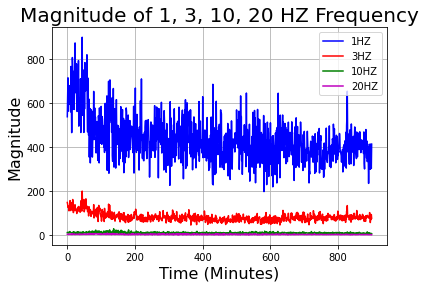

In [ ]:
# plt.plot(np.arange(16*60), magnitudes05, 'm-', label='0.5HZ')
plt.plot(np.arange(15*60), magnitudes[60:], 'b-', label='1HZ')
plt.plot(np.arange(15*60), magnitudes3[60:], 'r-', label='3HZ')
plt.plot(np.arange(15*60), magnitudes10[60:], 'g-', label='10HZ')
plt.plot(np.arange(15*60), magnitudes20[60:], 'm-', label='20HZ')

plt.legend(loc='best')
plt.grid()
plt.title('Magnitude of 1, 3, 10, 20 HZ Frequency',fontsize=20)
plt.xlabel('Time (Minutes)', fontsize=16)
plt.ylabel('Magnitude', fontsize=16)
plt.show()

In [ ]:
magnitudes025 = np.zeros(16*60)
magnitudes05 = np.zeros(16*60)
magnitudes75 = np.zeros(16*60)
magnitudes1 = np.zeros(16*60)
magnitudes2 = np.zeros(16*60)
# print(magnitudes20.size)
for hour in range(0,16):
    data=get_hour(hour)
    freqs, spect = welch_psd_per_bin(data, bin_length_sec=60, nperseg=80000, noverlap=40000)
#     print(freqs[1])
#     print(freqs[2])
#     print(freqs[4])
#     print(freqs[8])
    magnitudes025[hour*60:(hour+1)*60] = spect[:,1]
    magnitudes05[hour*60:(hour+1)*60] = spect[:,2]
    magnitudes75[hour*60:(hour+1)*60] = spect[:,3]
    magnitudes1[hour*60:(hour+1)*60] = spect[:,4]
    magnitudes2[hour*60:(hour+1)*60] = spect[:,8]
#     print(magnitudes20[hour*60:(hour+1)*60])

data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000
data.size = 72000000


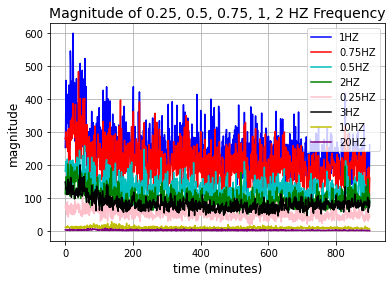

In [ ]:


plt.plot(np.arange(15*60), magnitudes1[60:], 'b-', label='1HZ')
plt.plot(np.arange(15*60), magnitudes75[60:], 'r-', label = '0.75HZ')
plt.plot(np.arange(15*60), magnitudes05[60:], 'c-', label = '0.5HZ')
plt.plot(np.arange(15*60), magnitudes2[60:], 'g-', label='2HZ')
plt.plot(np.arange(15*60), magnitudes025[60:], 'pink', label='0.25HZ')

plt.plot(np.arange(15*60), magnitudes3[60:], 'k-', label='3HZ')
plt.plot(np.arange(15*60), magnitudes10[60:], 'y-', label='10HZ')
plt.plot(np.arange(15*60), magnitudes20[60:], 'purple', label='20HZ')


plt.legend(loc='best')
plt.grid()
plt.title('Magnitude of 0.25, 0.5, 0.75, 1, 2 HZ Frequency',fontsize=14)
plt.xlabel('time (minutes)', fontsize=12)
plt.ylabel('magnitude', fontsize=12)
plt.show()

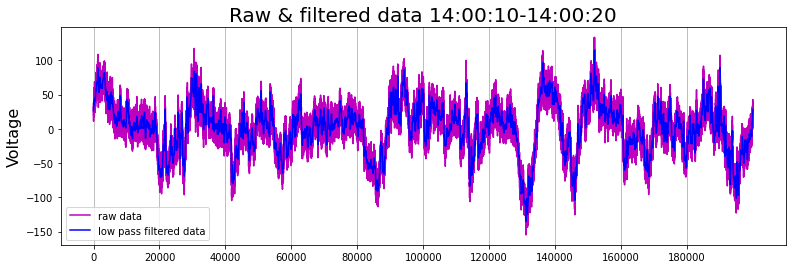

In [ ]:
fig, ax = plt.subplots(figsize=(13,4))
plt.plot(data14[second_to_sample(10):second_to_sample(20)], 'm-', label='raw data')
lpf = low_pass_filter(data14, T=600)
plt.plot(lpf[second_to_sample(10):second_to_sample(20)], 'b-', label='low pass filtered data')
plt.legend(loc='best')
ax.set_xticks(np.arange(0, 200000, 20000), minor=False)
ax.xaxis.grid(True, which='major')
plt.title('Raw & filtered data 14:00:10-14:00:20', fontsize=20)
plt.ylabel('Voltage', fontsize=16)
plt.show()

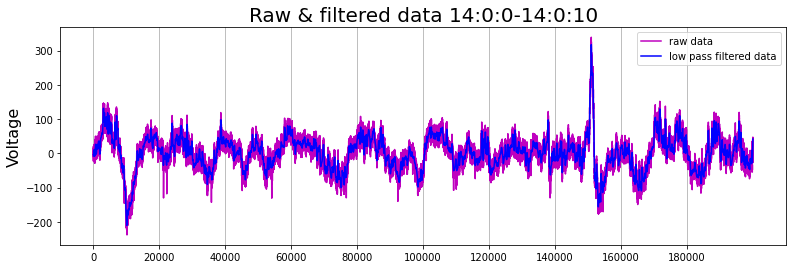

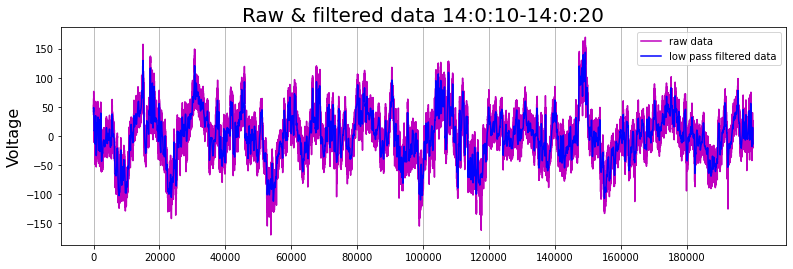

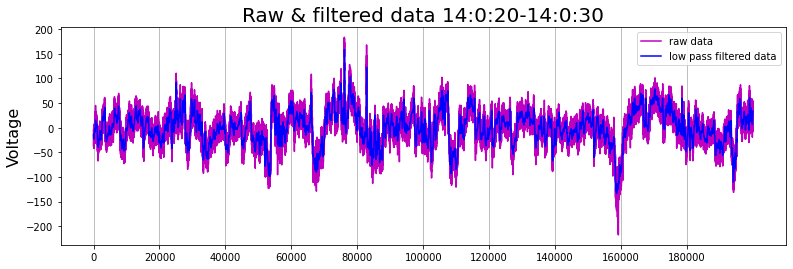

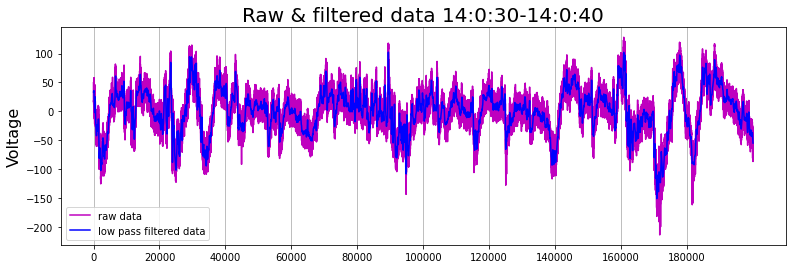

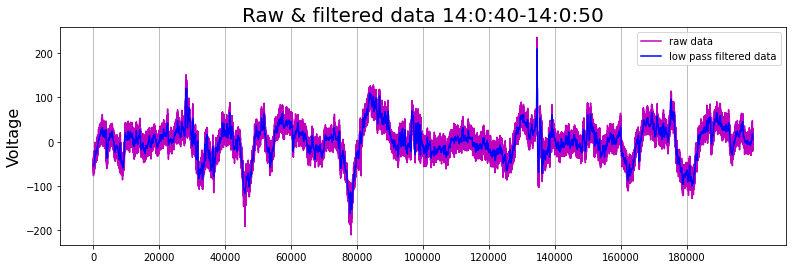

...

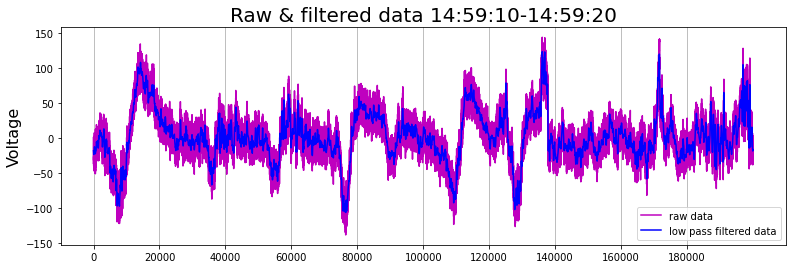

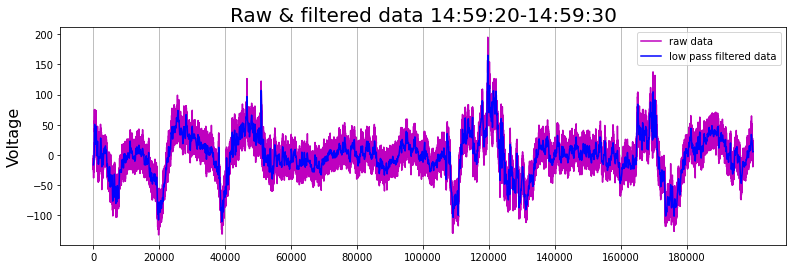

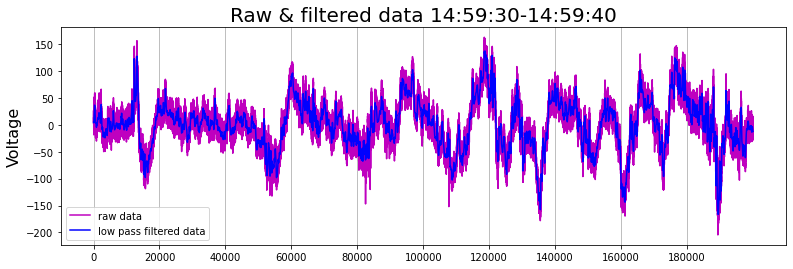

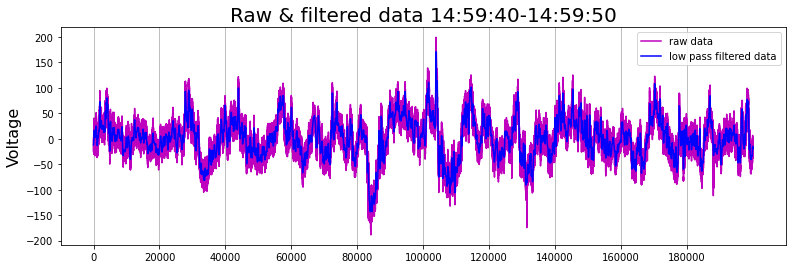

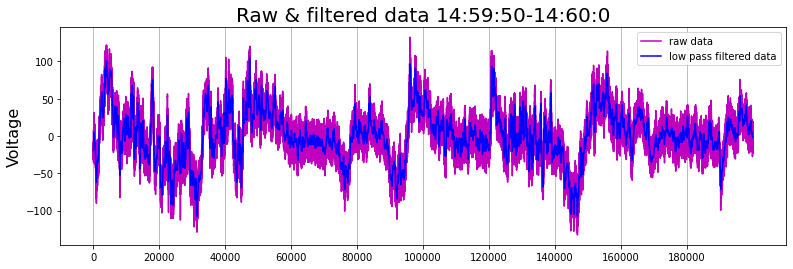

In [ ]:
for i in range(0, 3600, 10):
    fig, ax = plt.subplots(figsize=(13,4))
    plt.plot(data14[second_to_sample(i):second_to_sample(i+10)], 'm-', label='raw data')
    lpf = low_pass_filter(data14, T=600)
    plt.plot(lpf[second_to_sample(i):second_to_sample(i+10)], 'b-', label='low pass filtered data')
    
    """
    F = 1
    T = 10
    Fs = 20000
    Ts = 1./Fs
    N = int(T/Ts)

#     t = np.linspace(0, T, N)
    signal = np.sin(2*np.pi*F*t + 600)

    plt.plot(100*signal, 'g-', label='sine wave of 1HZ')
    """
    
    plt.legend(loc='best')
    ax.set_xticks(np.arange(0, 200000, 20000), minor=False)
    ax.xaxis.grid(True, which='major')
    plt.title('Raw & filtered data 14:%d:%d-14:%d:%d' %(i/60, i%60, (i+10)/60, (i+10)%60), fontsize=20)
    plt.ylabel('Voltage', fontsize=16)
    plt.show()